In [1]:
import numpy as np
from nptdms import TdmsFile
import matplotlib.pyplot as plt
import matplotlib.patches as patches

import soundfile as sf

from pathlib import Path

In [2]:
import scipy
import pandas as pd
import librosa
import warnings
import os

In [3]:
import sys

# append the path of the
# parent directory
sys.path.append('..')
sys.path.append('../src/')
sys.path.append('../src/models/bat_call_detector/batdetect2/')

import src.batdt2_pipeline as batdetect2_pipeline
import src.file_dealer as file_dealer
from bat_detect.detector import models
from cfg import get_config
from pipeline import pipeline
from utils.utils import gen_empty_df, convert_df_ravenpro
from bat_detect.utils import wavfile
import bat_detect.utils.detector_utils as du
import bat_detect.detector.compute_features as feats
import bat_detect.detector.post_process as pp

In [4]:
cfg = get_config()
cfg['tmp_dir'] = Path('../output/tmp')
cfg['output_dir'] = Path('../output_dir/mic_array_test_20240906/')
cfg['run_model'] = True
cfg['should_csv'] = True
cfg['save'] = True

In [23]:
def run_pipeline_on_file(file, cfg):
    bd_preds = pd.DataFrame()

    if not cfg['output_dir'].is_dir():
        cfg['output_dir'].mkdir(parents=True, exist_ok=True)
    if not cfg['tmp_dir'].is_dir():
        cfg['tmp_dir'].mkdir(parents=True, exist_ok=True)


    if (cfg['run_model']):
        cfg["csv_filename"] = f"batdetect2_pipeline_{file.name.split('.')[0]}"
        filepath = (cfg['output_dir'] / f'{cfg["csv_filename"]}.csv')
        # if not(filepath.is_file()):
        print(f"Generating detections for {file.name}")
        segmented_file_paths = batdetect2_pipeline.generate_segmented_paths([file], cfg)
        file_path_mappings = batdetect2_pipeline.initialize_mappings(segmented_file_paths, cfg)
        bd_preds = batdetect2_pipeline.run_models(file_path_mappings)
        if cfg['save']:
            batdetect2_pipeline._save_predictions(bd_preds, cfg['output_dir'], cfg)
        batdetect2_pipeline.delete_segments(segmented_file_paths)
        # else:
        #     bd_preds = pd.read_csv(filepath)

    return bd_preds

In [7]:
def plot_audio_seg_spec(audio_features, spec_features):
    audio_seg = audio_features['audio_seg']
    fs = audio_features['sample_rate']
    start = audio_features['start']
    duration = audio_features['duration']

    vmax = spec_features['vmax']
    vmin = spec_features['vmin']
    cmap = spec_features['cmap']
    nfft = spec_features['NFFT']

    plt.figure(figsize=(15, 5))
    plt.rcParams.update({'font.size': 18})
    plt.title(f"Spectrogram of {audio_features['plot_title']}", fontsize=24)
    plt.specgram(audio_seg, NFFT=nfft, cmap=cmap, vmin=vmin, vmax=vmax, mode='magnitude', scale='dB')
    plt.yticks(ticks=np.linspace(0, 1, 6), labels=np.linspace(0, fs/2000, 6).astype('int'))
    plot_xtype = 'float'
    if (duration > 60):
        plot_xtype = 'int'
    plt.xticks(ticks=np.linspace(0, duration*(fs/2), 11), 
               labels=np.round(np.linspace(start, start+duration, 11, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Frequency (kHz)")
    plt.xlabel("Time (s)")
    plt.colorbar()
    plt.show()

def plot_audio_seg_signal(audio_features):
    audio_seg = audio_features['audio_seg']
    fs = audio_features['sample_rate']
    start = audio_features['start']
    duration = audio_features['duration']

    plt.figure(figsize=(15, 5))
    plt.rcParams.update({'font.size': 18})
    plt.title(f"Signal of {audio_features['plot_title']}", fontsize=24)
    plt.plot(audio_seg)
    plot_xtype = 'float'
    plt.xlim(0, duration*fs)
    plt.xticks(ticks=np.linspace(0, audio_features['duration']*fs, 11), 
                labels=np.round(np.linspace(start, start+duration, 11, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Voltage (V)")
    plt.xlabel("Time (s)")
    plt.show()

def plot_audio_seg_fft(audio_features):
    audio_seg = audio_features['audio_seg']
    fs = audio_features['sample_rate']
    start = audio_features['start']
    duration = audio_features['duration']

    plt.figure(figsize=(15, 5))
    plt.rcParams.update({'font.size': 18})
    plt.title(f"FFT of {audio_features['plot_title']}", fontsize=24)
    abs_sig = np.abs(scipy.fft.rfft(audio_seg, n=len(audio_seg)))
    abs_sig = abs_sig / len(abs_sig)
    plt.plot(20*np.log10(abs_sig/np.max(abs_sig)))
    plot_xtype = 'int'
    plt.xticks(ticks=np.linspace(0, len(abs_sig), 11), 
                labels=np.round(np.linspace(0, (fs/2), 11, dtype=plot_xtype), 2)/1e3, rotation=30)
    plt.ylabel("Voltage (dB)")
    plt.xlabel("Frequency (kHz)")
    plt.grid(which='both')
    plt.show()
    
FREQ_COLORS = {'LF':'cyan',
               'HF':'orange'}

def plot_colored_dets_over_audio(audio_features, spec_features, plot_dets):
    audio_seg = audio_features['audio_seg']
    fs = audio_features['sample_rate']
    start = audio_features['start']
    duration = audio_features['duration']

    vmax = spec_features['vmax']
    vmin = spec_features['vmin']
    cmap = spec_features['cmap']
    nfft = spec_features['NFFT']

    plt.figure(figsize=(15, 5))
    plt.rcParams.update({'font.size': 24})
    plt.title(f"Spectrogram of {audio_features['plot_title']}", fontsize=24)
    plt.specgram(audio_seg, NFFT=nfft, cmap=cmap, vmin=vmin, vmax=vmax, mode='magnitude', scale='dB')

    ax = plt.gca()
    for i, row in plot_dets.iterrows():
        rect = patches.Rectangle(((row['start_time'] - start)*(fs/2), row['low_freq']/(fs/2)), 
                        (row['end_time'] - row['start_time'])*(fs/2), (row['high_freq'] - row['low_freq'])/(fs/2), 
                        linewidth=2, edgecolor=FREQ_COLORS[row['KMEANS_CLASSES']], facecolor='none', alpha=0.8)
        ax.add_patch(rect)

    plt.yticks(ticks=np.linspace(0, 1, 6), labels=np.linspace(0, fs/2000, 6).astype('int'))
    plot_xtype = 'float'
    if (duration > 60):
        plot_xtype = 'int'
    plt.xticks(ticks=np.linspace(0, duration*(fs/2), 11), 
               labels=np.round(np.linspace(start, start+duration, 11, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Frequency (kHz)")
    plt.xlabel("Time (s)")
    plt.show()

In [8]:
def get_snr_from_band_limited_signal(snr_call_signal, snr_noise_signal): 

    signal_power_rms = np.sqrt(np.square(snr_call_signal).mean())
    noise_power_rms = np.sqrt(np.square(snr_noise_signal).mean())
    snr = abs(20 * np.log10(signal_power_rms / noise_power_rms))

    return snr


def bandpass_audio_signal(audio_seg, fs, low_freq_cutoff, high_freq_cutoff):
    nyq = fs // 2
    low_cutoff = (low_freq_cutoff) / nyq
    high_cutoff =  (high_freq_cutoff) / nyq
    b, a = scipy.signal.butter(4, [low_cutoff, high_cutoff], btype='band', analog=False)
    band_limited_audio_seg = scipy.signal.filtfilt(b, a, audio_seg)

    return band_limited_audio_seg

In [9]:
audiomoth_dir = '/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/audiomoth/recover-20240907'
files_from_loc = sorted(list(Path(audiomoth_dir).glob(pattern='*.WAV')))
files_from_loc

[PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/audiomoth/recover-20240907/20240907_022821.WAV'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/audiomoth/recover-20240907/20240907_022900.WAV'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/audiomoth/recover-20240907/20240907_023000.WAV'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/audiomoth/recover-20240907/20240907_023100.WAV'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/audiomoth/recover-20240907/20240907_023200.WAV'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/audiomoth/recover-20240907/20240907_023300.WAV'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/audiomoth/recover-20240907/20240907_023400.WAV'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mi

Generating detections for 20240907_032000.WAV


100%|██████████| 2/2 [00:16<00:00,  8.30s/it]


Median LF frequency in File: nan
Median HF frequency in File: 48960.0


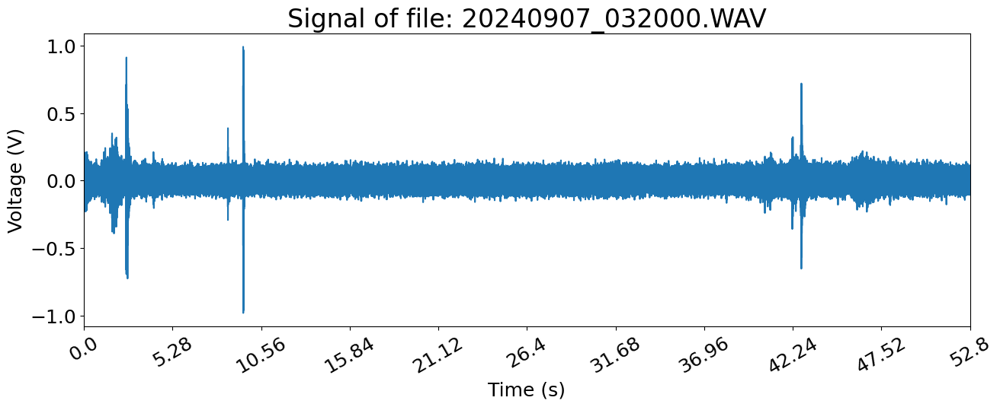

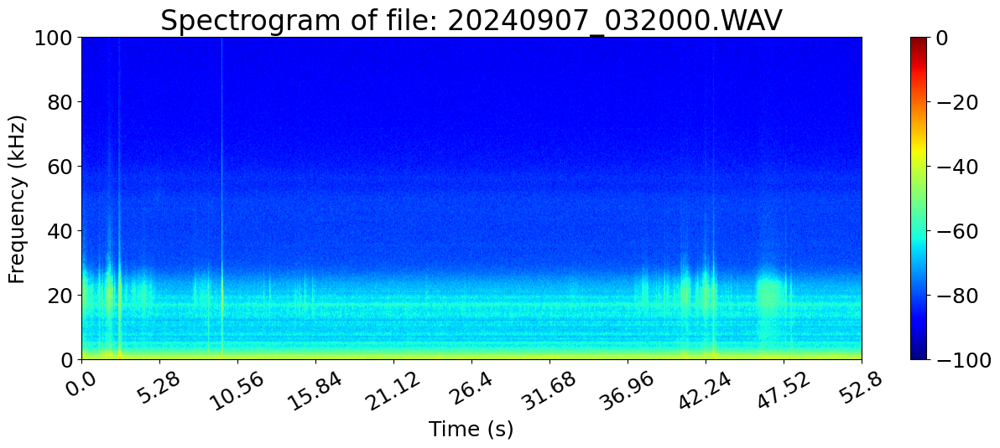

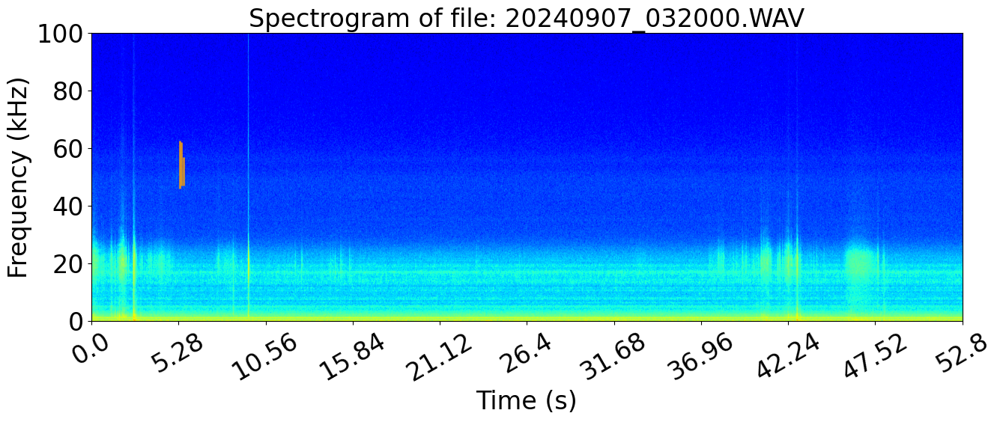

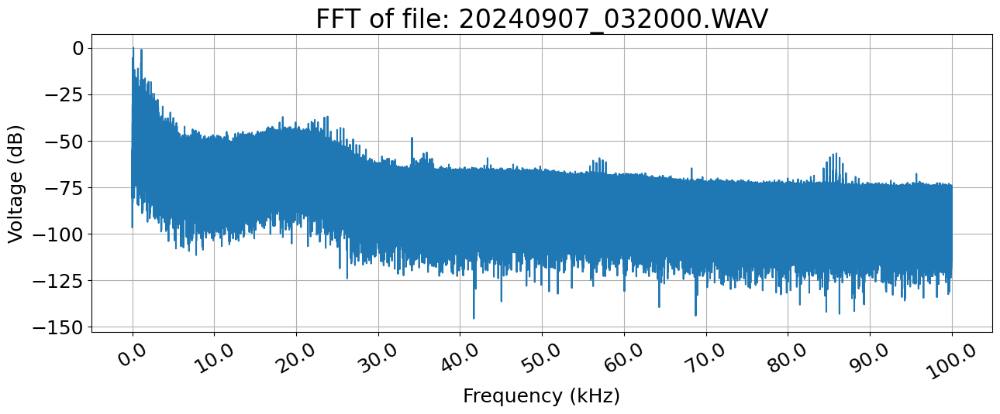

Generating detections for 20240907_032100.WAV


100%|██████████| 2/2 [00:16<00:00,  8.22s/it]


Median LF frequency in File: nan
Median HF frequency in File: nan


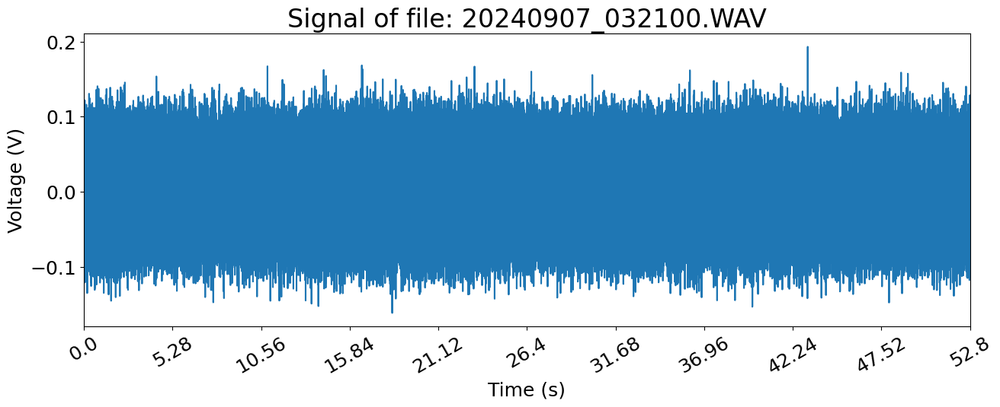

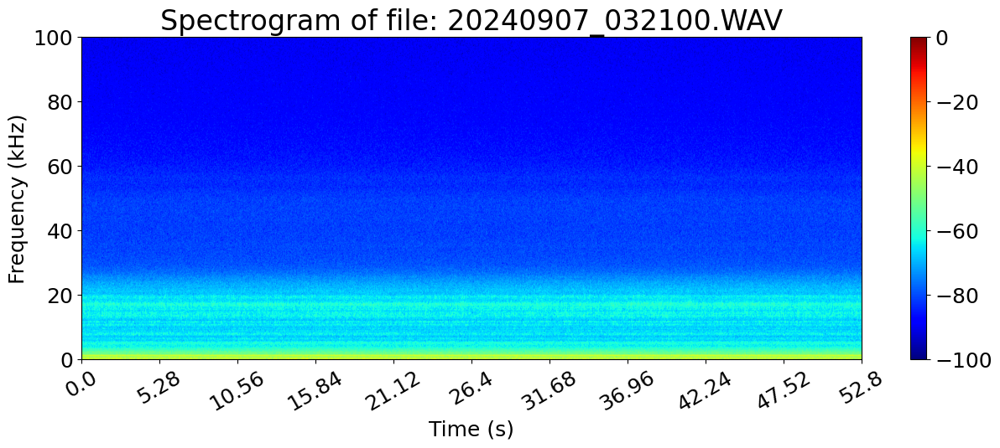

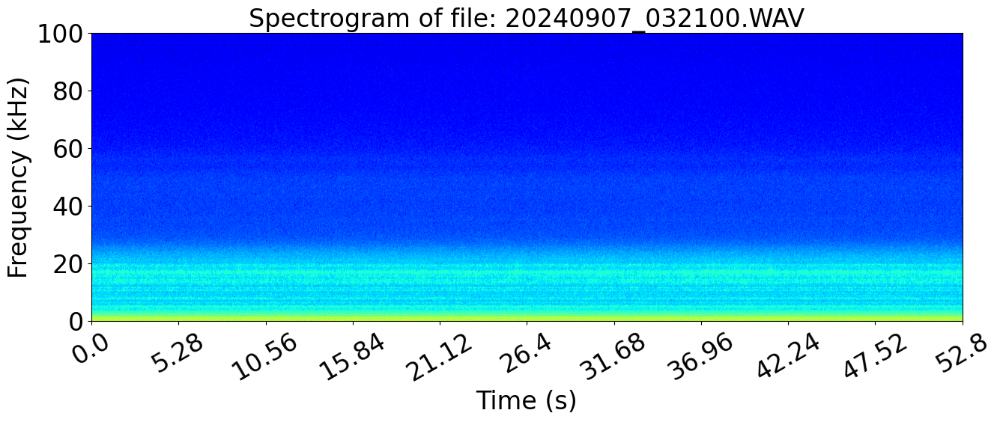

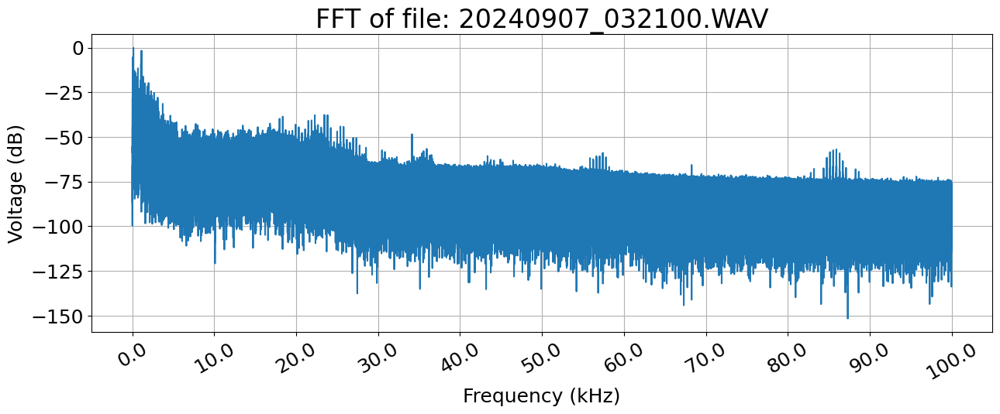

Generating detections for 20240907_032200.WAV


100%|██████████| 2/2 [00:15<00:00,  7.74s/it]


Median LF frequency in File: nan
Median HF frequency in File: 48960.0


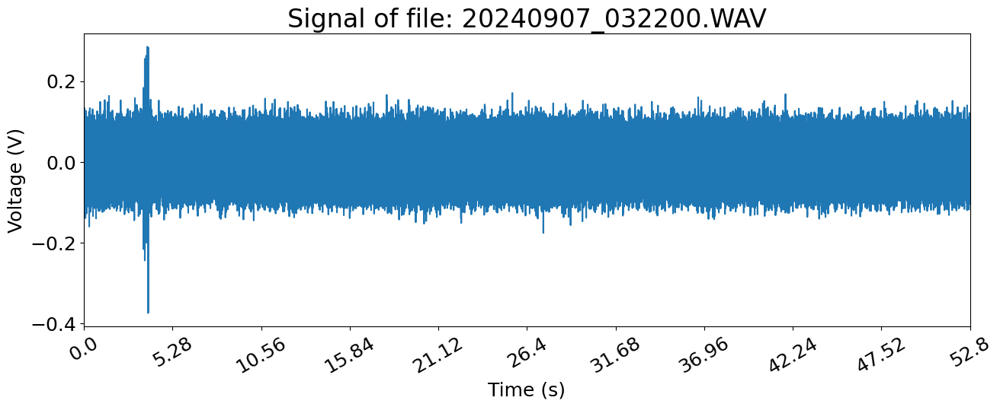

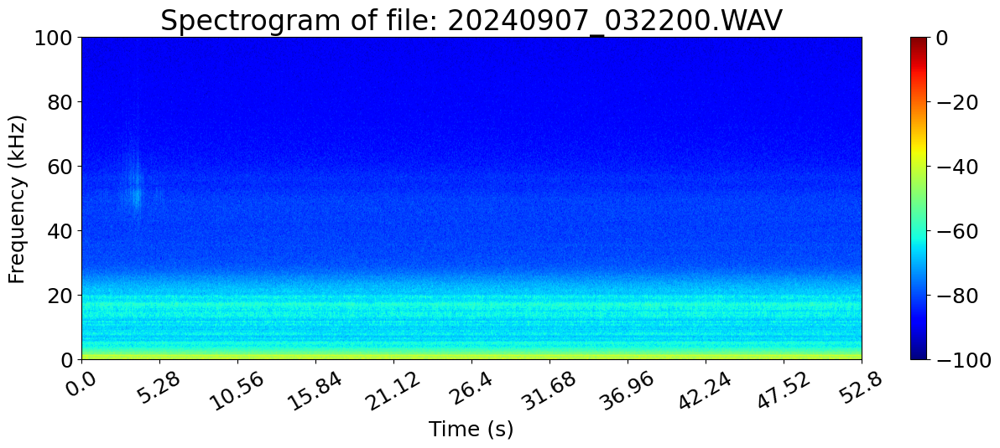

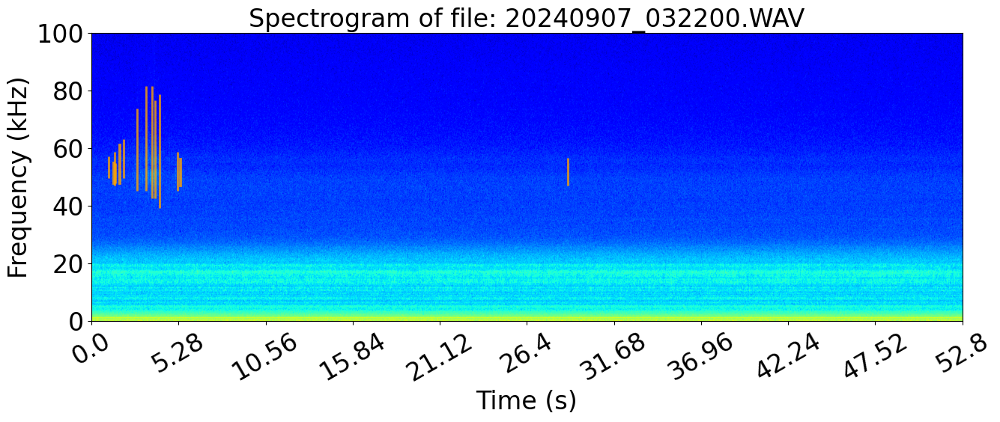

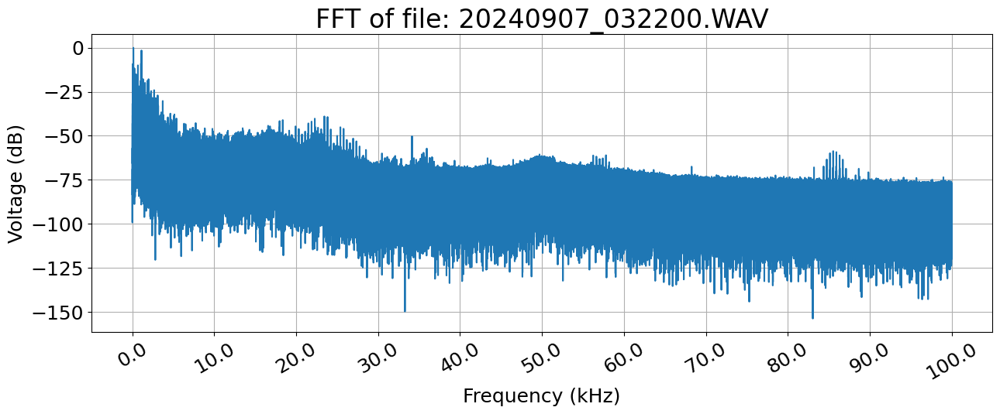

Generating detections for 20240907_032300.WAV


100%|██████████| 2/2 [00:15<00:00,  7.91s/it]


Median LF frequency in File: nan
Median HF frequency in File: 48960.0


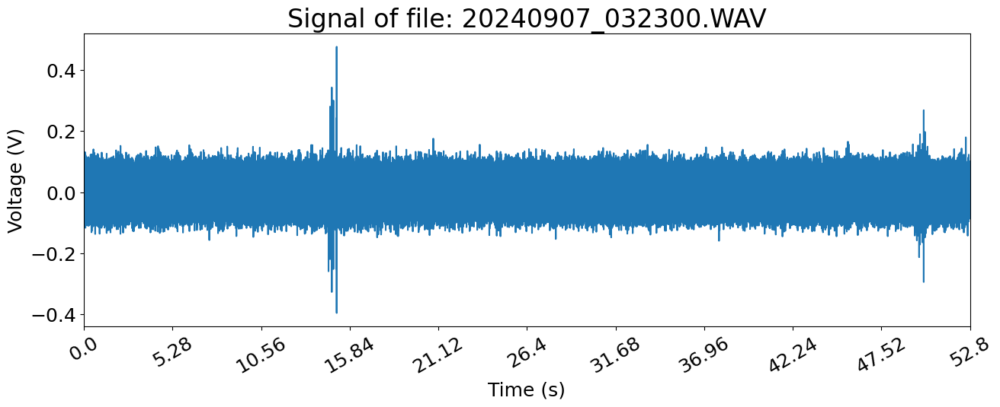

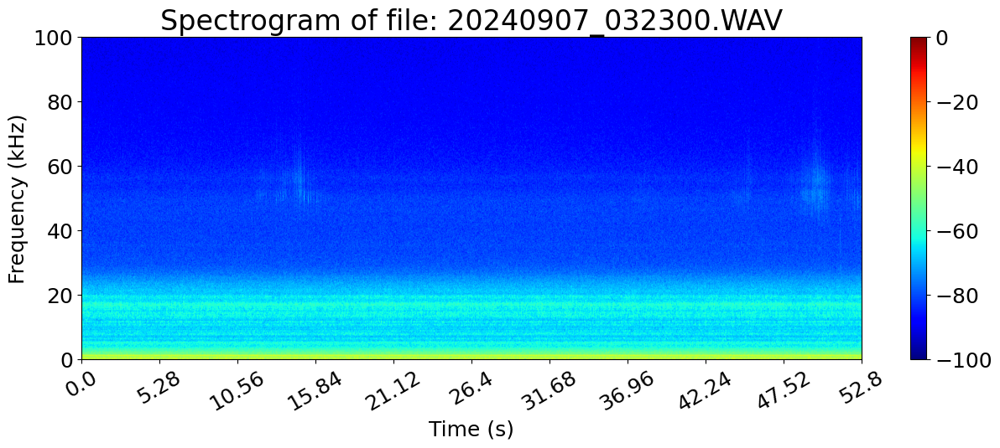

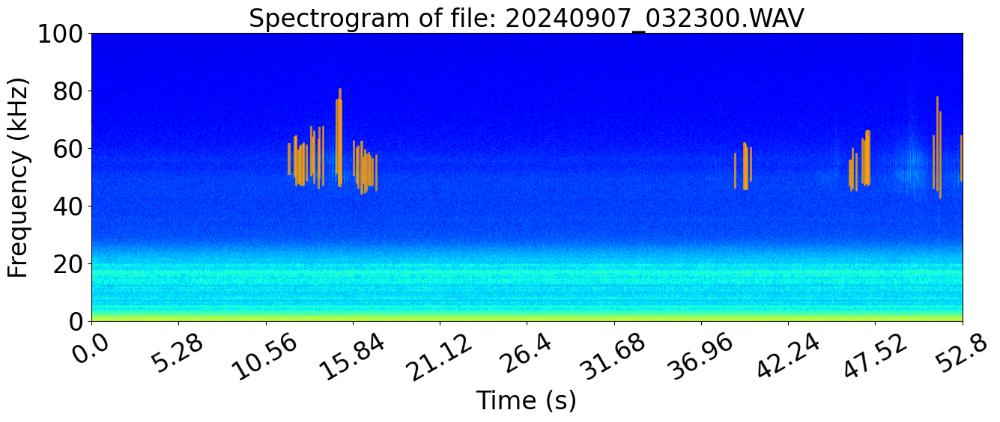

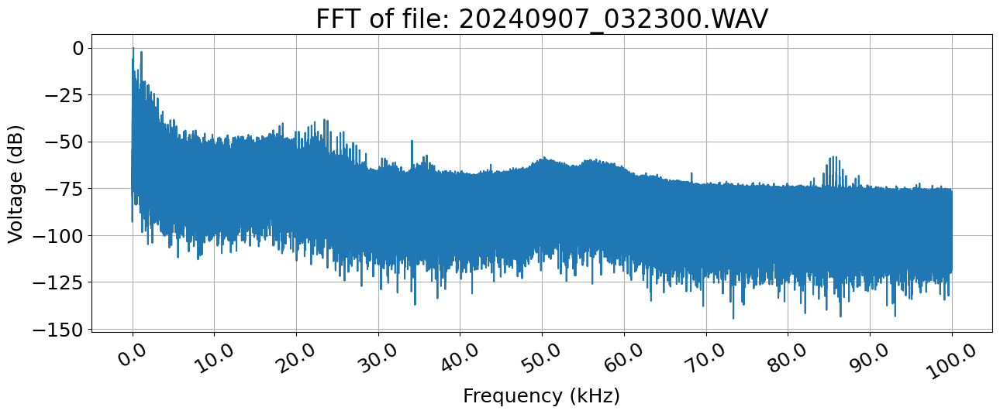

Generating detections for 20240907_032400.WAV


100%|██████████| 2/2 [00:16<00:00,  8.04s/it]


Median LF frequency in File: nan
Median HF frequency in File: 49920.0


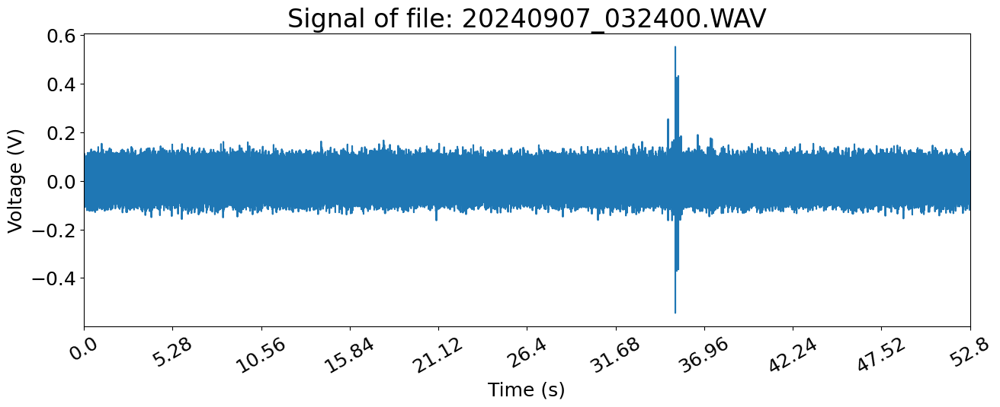

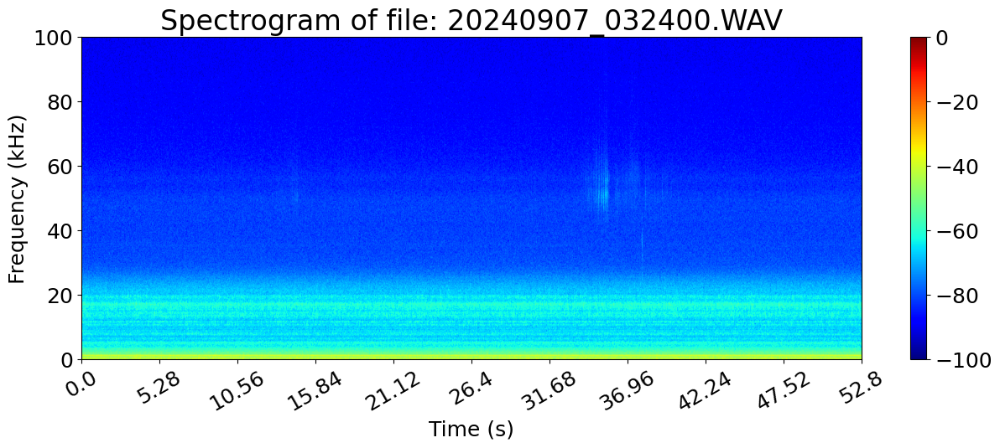

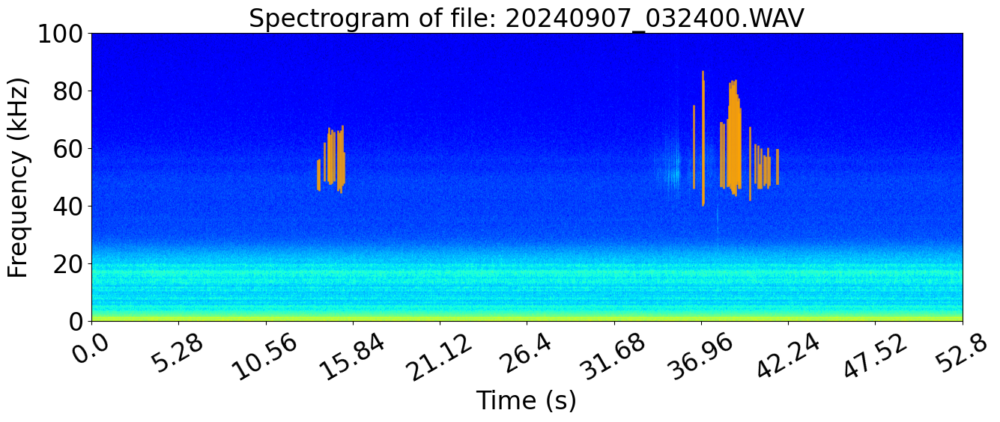

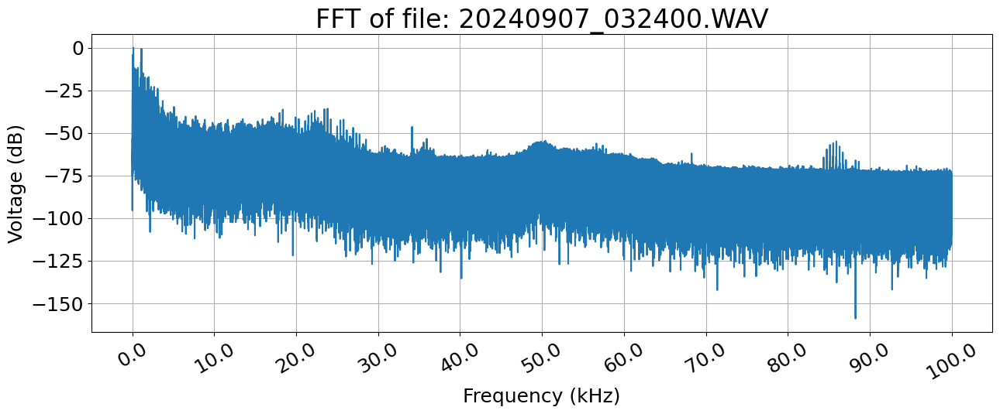

Generating detections for 20240907_032500.WAV


100%|██████████| 2/2 [00:15<00:00,  7.76s/it]


Median LF frequency in File: 24000.0
Median HF frequency in File: 48960.0


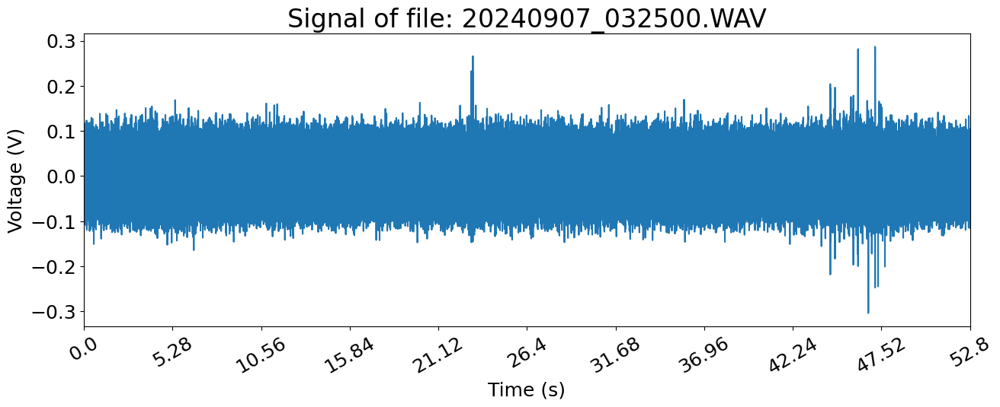

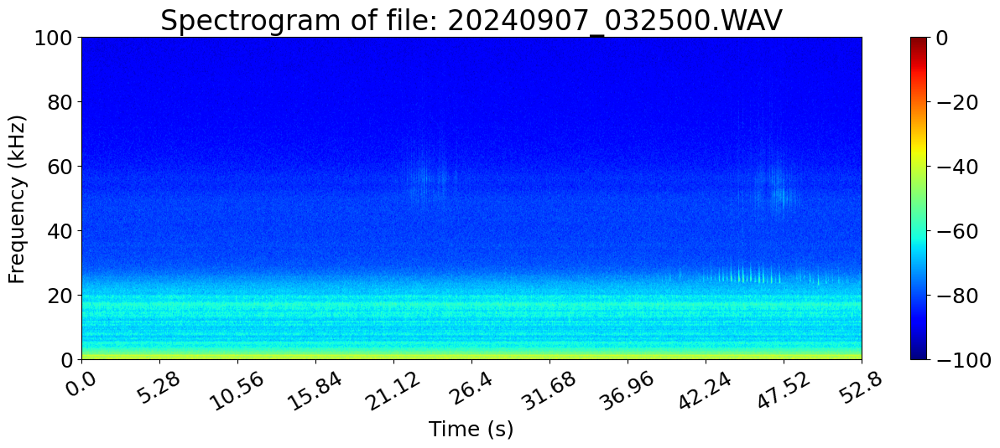

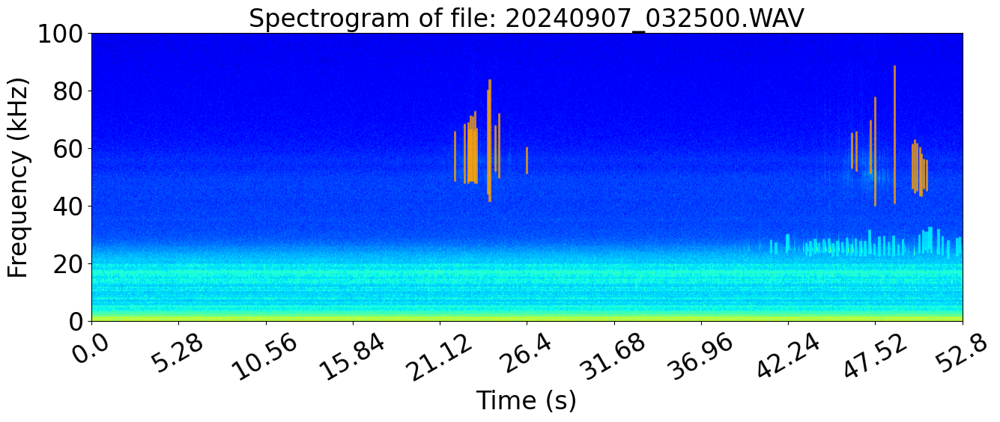

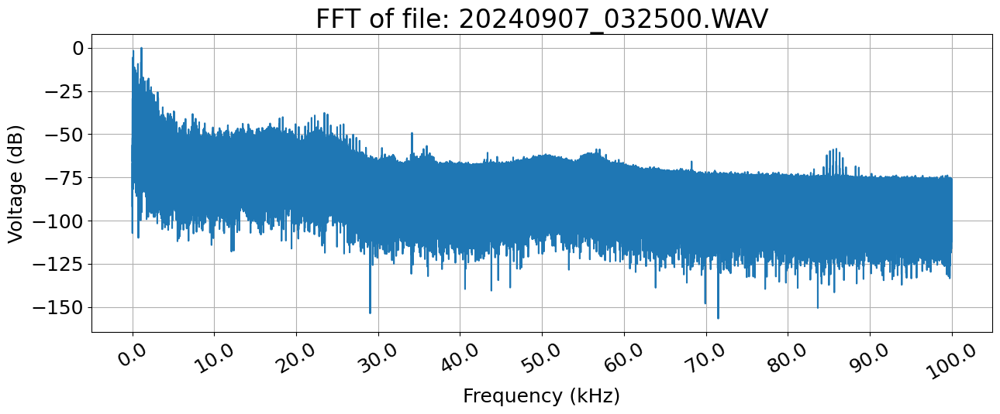

Generating detections for 20240907_032600.WAV


100%|██████████| 2/2 [00:16<00:00,  8.28s/it]


Median LF frequency in File: nan
Median HF frequency in File: 48960.0


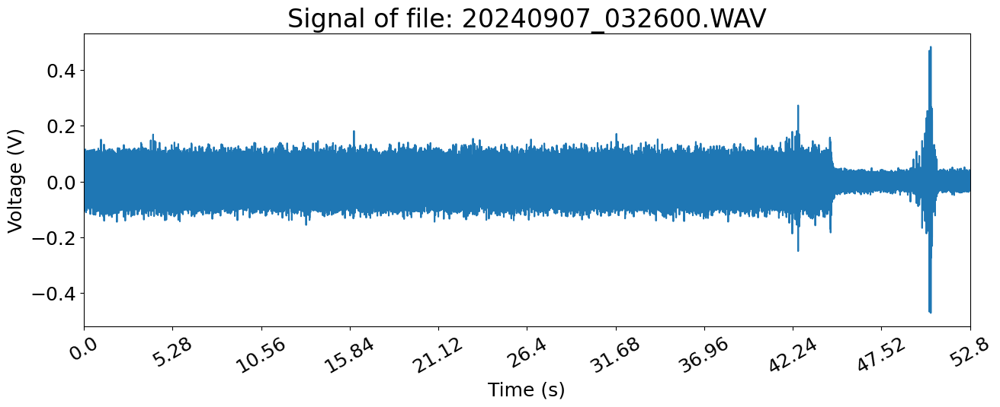

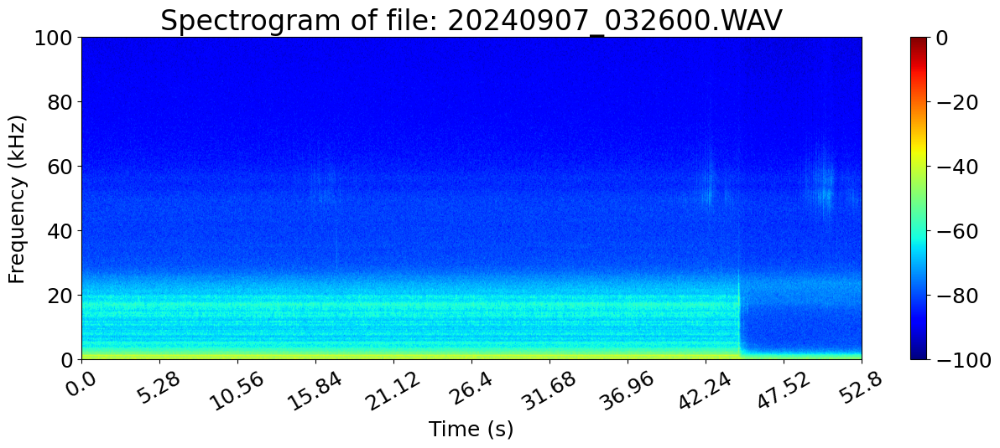

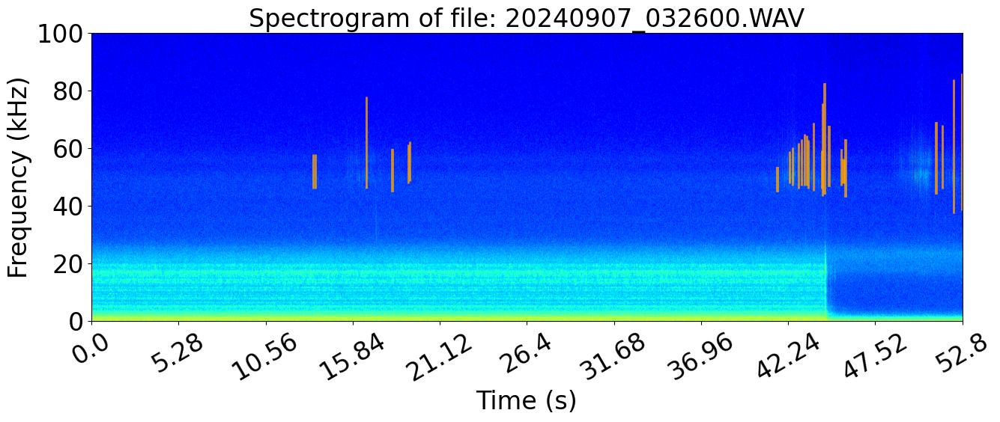

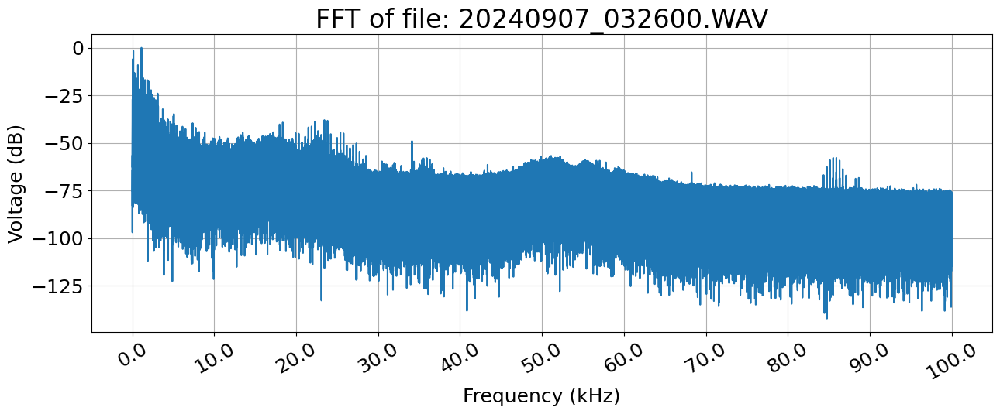

Generating detections for 20240907_032700.WAV


100%|██████████| 2/2 [00:17<00:00,  8.60s/it]


Median LF frequency in File: nan
Median HF frequency in File: 48960.0


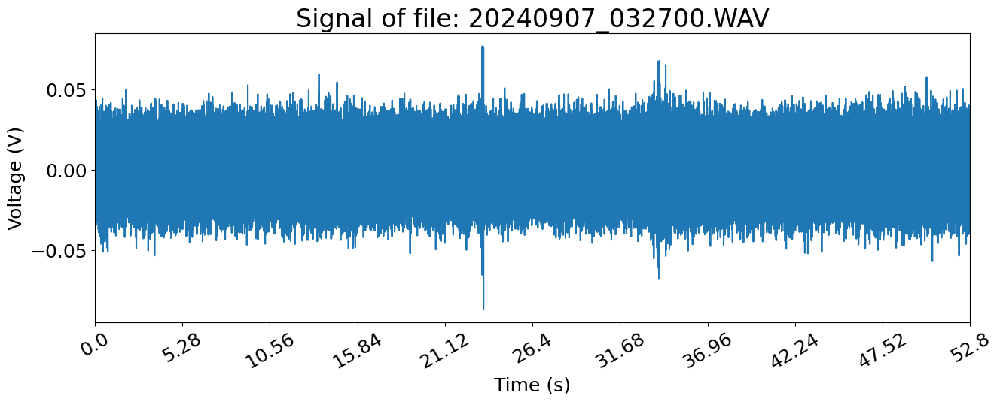

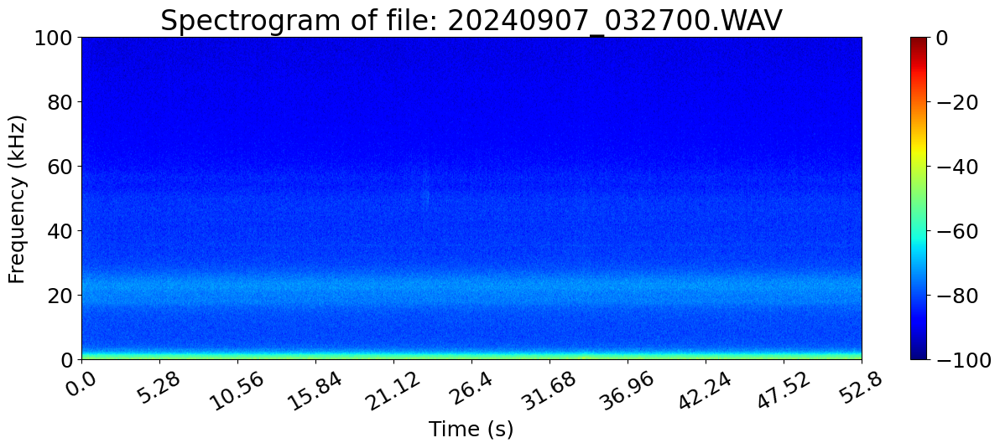

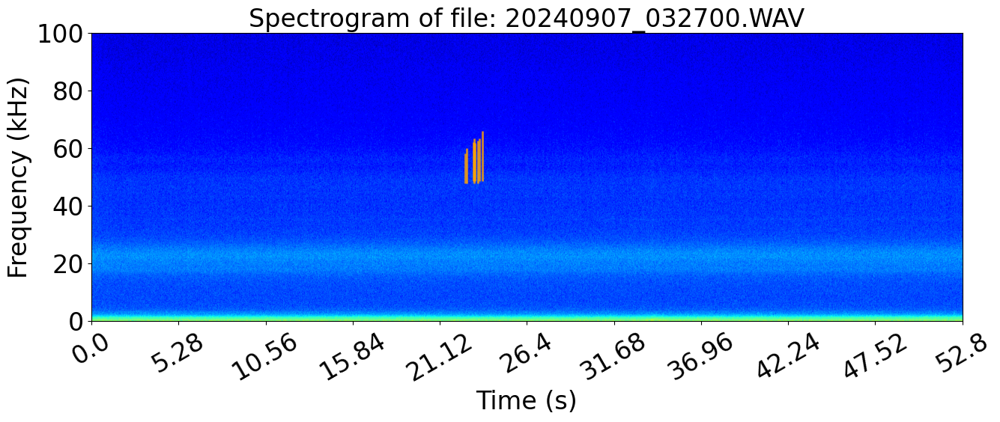

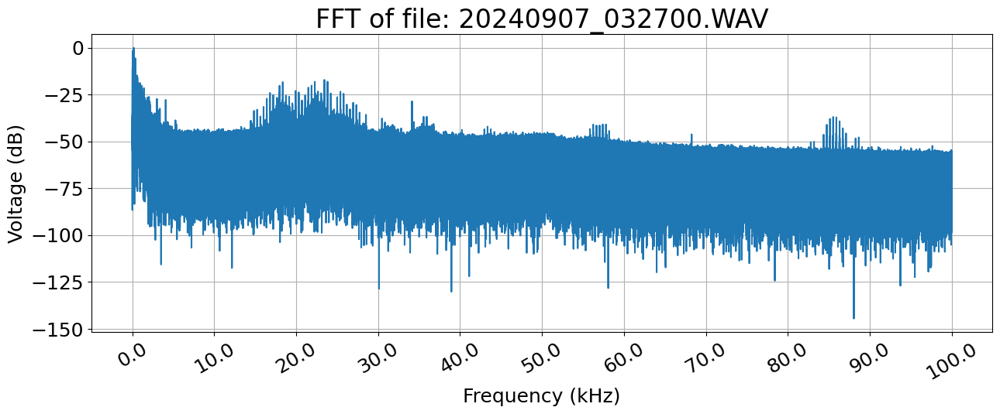

Generating detections for 20240907_032800.WAV


100%|██████████| 2/2 [00:16<00:00,  8.18s/it]


Median LF frequency in File: nan
Median HF frequency in File: 53760.0


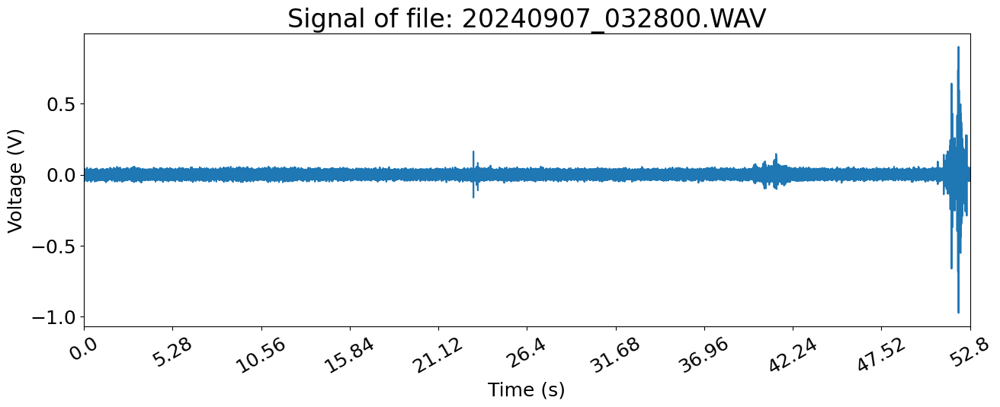

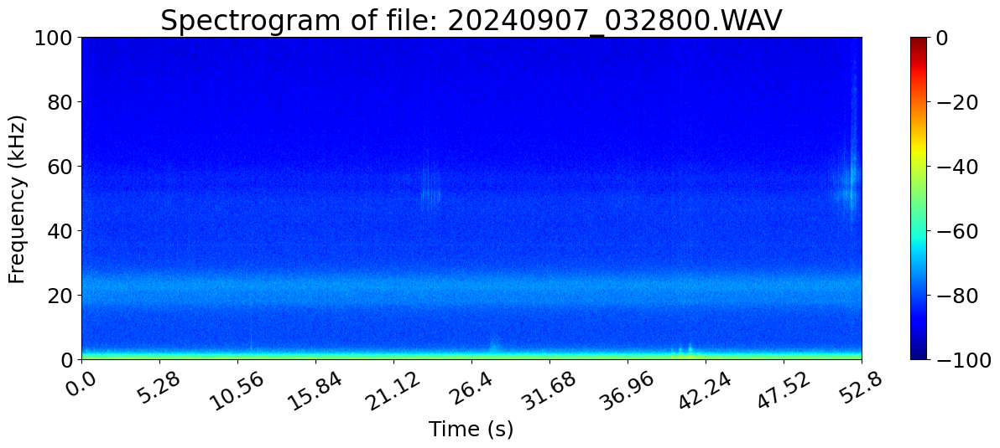

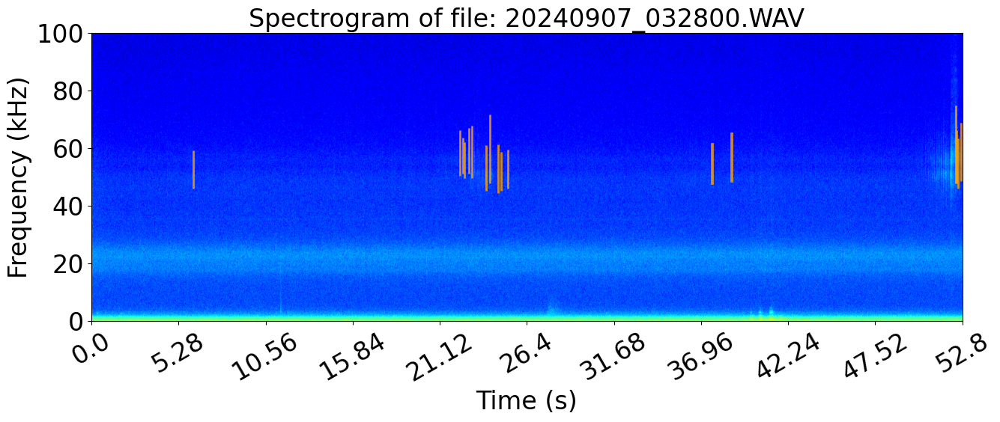

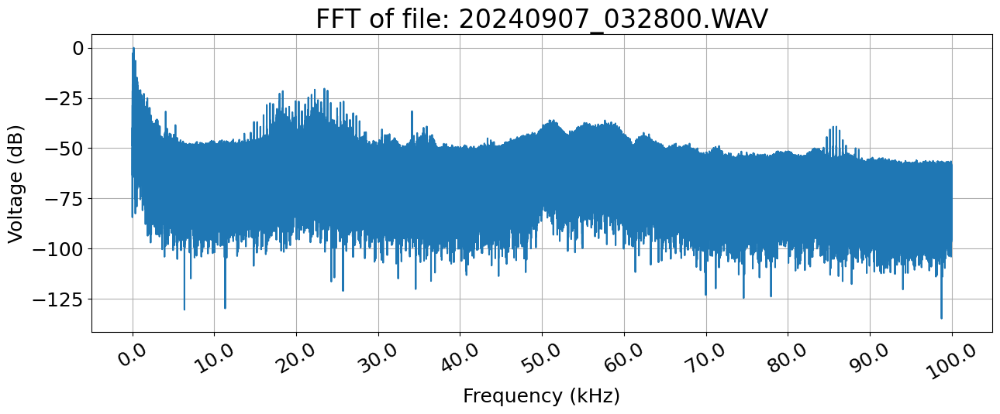

Generating detections for 20240907_032900.WAV


100%|██████████| 2/2 [00:15<00:00,  7.65s/it]


Median LF frequency in File: 26880.0
Median HF frequency in File: 48960.0


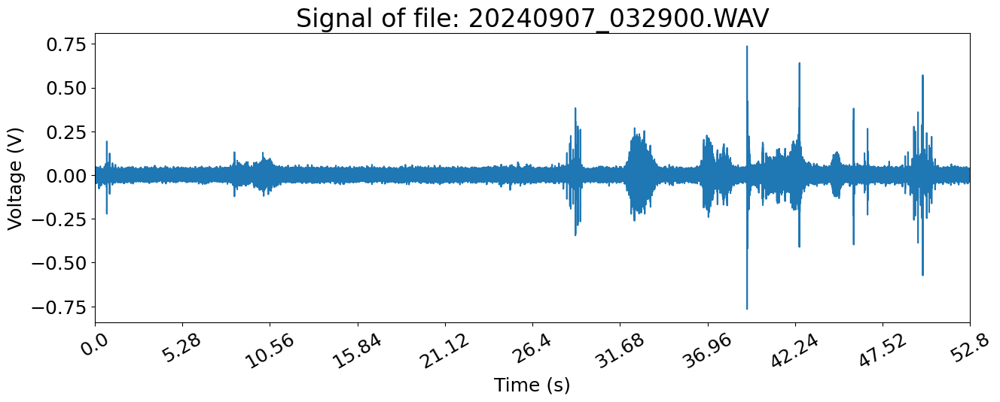

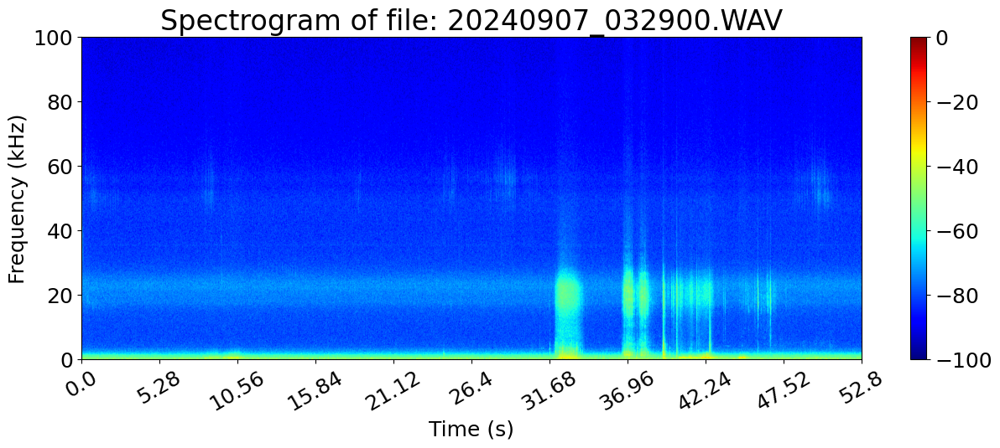

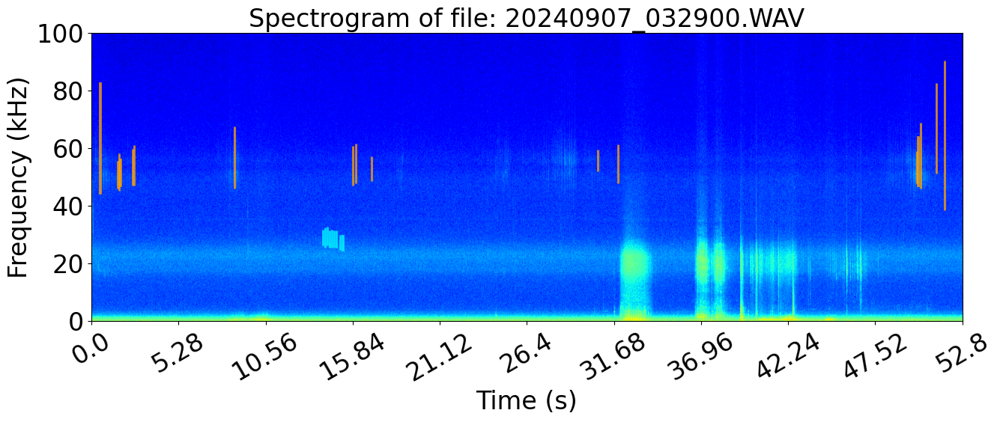

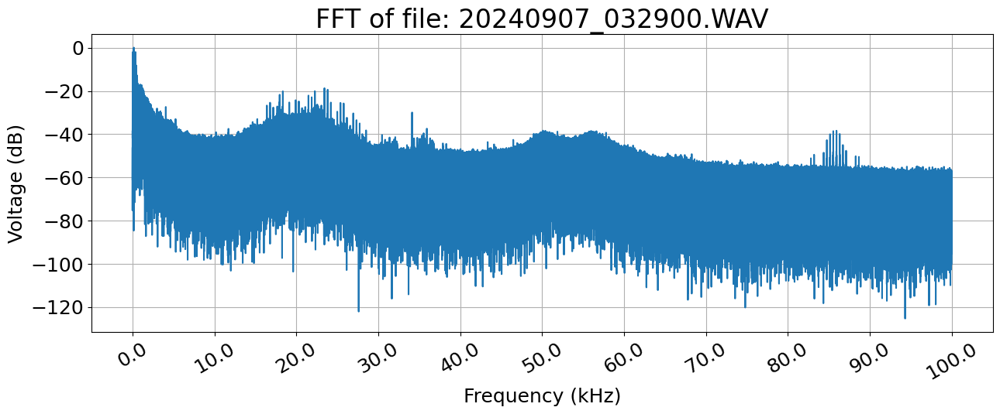

In [10]:
for file in files_from_loc[52:62]:
    # tdms_file = TdmsFile.read(file)
    # group_name = tdms_file.groups()[0].name
    # group = tdms_file[group_name]
    # channel_name = group.channels()[0].name
    # channel = group[channel_name]
    fs = 200000
    # sf.write(write_file, channel[:], int(fs))
    cfg['input_audio'] = Path(file)
    dets = run_pipeline_on_file(file, cfg)
    recorded_audio = sf.SoundFile(file)

    max_dur = 60
    for start in np.arange(0, (recorded_audio.frames/fs)-1, max_dur):
        recorded_audio.seek(int(fs*start))
        duration = min(max_dur, (recorded_audio.frames - recorded_audio.tell()) / fs)
        audio_seg = recorded_audio.read(int(fs*duration))
        vmax = 0
        vmin = -100

        audio_features = dict()
        audio_features['file_path'] = Path(file)
        audio_features['audio_seg'] = audio_seg
        audio_features['sample_rate'] = fs
        audio_features['start'] = start
        audio_features['duration'] = duration

        spec_features = dict()
        spec_features['NFFT'] = 1024 # When segments are short, NFFT should also be small to best see calls (must always be > 128)
        spec_features['cmap'] = 'jet' # This colormap shows best contrast between noise and signals
        spec_features['vmin'] = vmin
        spec_features['vmax'] = vmax

        audio_features['plot_title'] = f"file: {audio_features['file_path'].name}"
        plot_audio_seg_signal(audio_features)
        plot_audio_seg_spec(audio_features, spec_features)
        plot_dets = dets.loc[(dets['start_time']>=start)&(dets['end_time']<=(start+duration))]
        plot_dets = plot_dets.sort_values(by='start_time')
        plot_dets.reset_index(drop=True, inplace=True)
        plot_colored_dets_over_audio(audio_features, spec_features, plot_dets)
        plot_audio_seg_fft(audio_features)

In [11]:
import dask.dataframe as dd

all_audiomoth_files = dd.read_csv('../output_dir/mic_array_test_20240906/batdetect2_pipeline_20240907_032*.csv').compute()
all_audiomoth_files

,KMEANS_CLASSES,peak_frequency,SNR,start_time,end_time,low_freq,high_freq,class,class_prob,det_prob,individual,event,sampling_rate,input_file
0,HF,47040.0,14.149057,5.3675,5.3721,46093.0,62612.0,Pipistrellus pipistrellus,0.575,0.623,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
1,HF,48960.0,11.867357,5.4375,5.4414,46953.0,62097.0,Pipistrellus pipistrellus,0.560,0.601,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
2,HF,49920.0,7.383424,5.5785,5.5836,46953.0,56873.0,Pipistrellus pipistrellus,0.537,0.559,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
0,HF,49920.0,3.498268,1.0395,1.0448,49531.0,57110.0,Pipistrellus pipistrellus,0.488,0.503,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
1,HF,48960.0,5.033962,1.3375,1.3440,47812.0,55071.0,Pipistrellus pipistrellus,0.547,0.566,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22,LF,25920.0,10.665491,15.0835,15.0954,24609.0,29783.0,Nyctalus leisleri,0.463,0.658,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
23,LF,24960.0,2.641905,15.2255,15.2372,24609.0,29729.0,Nyctalus leisleri,0.287,0.516,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
24,HF,48960.0,5.106577,15.8415,15.8465,46953.0,60833.0,Pipistrellus pipistrellus,0.500,0.538,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
25,HF,48960.0,6.180054,16.0175,16.0222,47812.0,61691.0,Pipistrellus pipistrellus,0.505,0.557,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...


In [56]:
lf_audiomoth_dets = all_audiomoth_files[all_audiomoth_files['KMEANS_CLASSES']=='LF']
hf_audiomoth_dets = all_audiomoth_files[all_audiomoth_files['KMEANS_CLASSES']=='HF']

In [57]:
selection_audiomoth = all_audiomoth_files.sort_values(by='SNR', ascending=False)[:100].reset_index(drop=True).copy()
selection_audiomoth

,KMEANS_CLASSES,peak_frequency,SNR,start_time,end_time,low_freq,high_freq,class,class_prob,det_prob,individual,event,sampling_rate,input_file
0,HF,48960.0,34.208756,54.2045,54.2090,39218.0,97127.0,Myotis alcathoe,0.517,0.564,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
1,HF,49920.0,33.318702,44.3305,44.3357,43515.0,75594.0,Pipistrellus pipistrellus,0.480,0.572,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
2,HF,48000.0,32.090260,51.7185,51.7238,38359.0,90334.0,Myotis alcathoe,0.300,0.510,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
3,HF,55680.0,30.688242,54.4435,54.4483,41796.0,109801.0,Myotis alcathoe,0.385,0.586,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
4,HF,53760.0,30.400046,54.0525,54.0570,40078.0,96088.0,Myotis alcathoe,0.522,0.577,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,HF,49920.0,15.040014,46.7385,46.7429,47812.0,63675.0,Pipistrellus pipistrellus,0.538,0.584,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
96,HF,46080.0,15.010706,54.3445,54.3493,44375.0,59837.0,Pipistrellus pipistrellus,0.475,0.615,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
97,HF,52800.0,14.917739,47.1175,47.1221,47812.0,65963.0,Pipistrellus pipistrellus,0.510,0.590,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
98,HF,48960.0,14.500367,50.2425,50.2478,43515.0,60648.0,Pipistrellus pipistrellus,0.479,0.550,-1,Echolocation,192000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...


Text(0.5, 0, 'SNR')

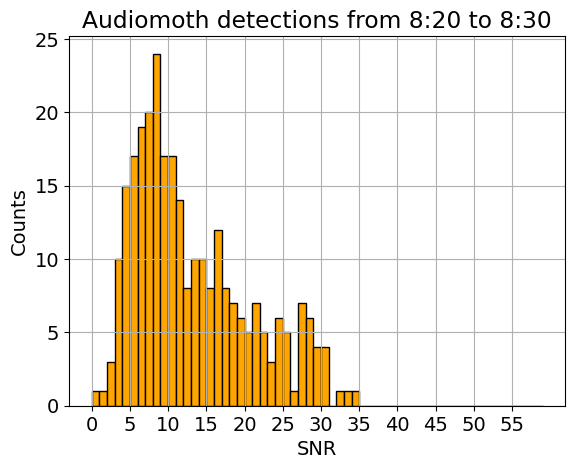

In [67]:
plt.rcParams.update({'font.size':14})
(all_audiomoth_files['SNR'].sort_values()).hist(bins=np.arange(0, 60, 1), facecolor='orange', edgecolor='k', density=False)
# plt.yscale('log')
plt.title('Audiomoth detections from 8:20 to 8:30')
plt.xticks(np.arange(0, 60, 5))
plt.ylabel('Counts')
plt.xlabel('SNR')

Text(0.5, 0, 'SNR')

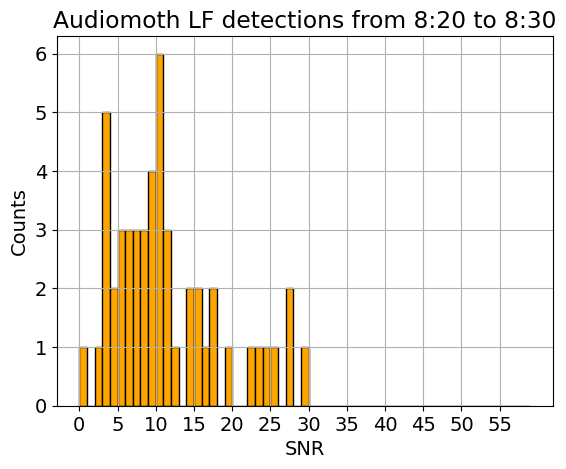

In [69]:
plt.rcParams.update({'font.size':14})
(lf_audiomoth_dets['SNR'].sort_values()).hist(bins=np.arange(0, 60, 1), facecolor='orange', edgecolor='k', density=False)
# plt.yscale('log')
plt.title('Audiomoth LF detections from 8:20 to 8:30')
plt.xticks(np.arange(0, 60, 5))
plt.ylabel('Counts')
plt.xlabel('SNR')

Text(0.5, 0, 'SNR')

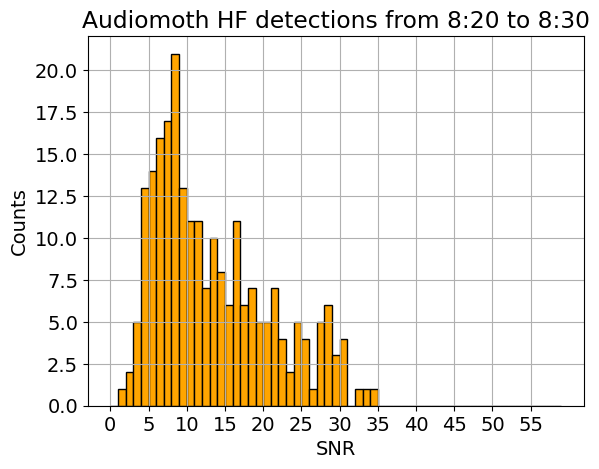

In [70]:
plt.rcParams.update({'font.size':14})
(hf_audiomoth_dets['SNR'].sort_values()).hist(bins=np.arange(0, 60, 1), facecolor='orange', edgecolor='k', density=False)
# plt.yscale('log')
plt.title('Audiomoth HF detections from 8:20 to 8:30')
plt.xticks(np.arange(0, 60, 5))
plt.ylabel('Counts')
plt.xlabel('SNR')

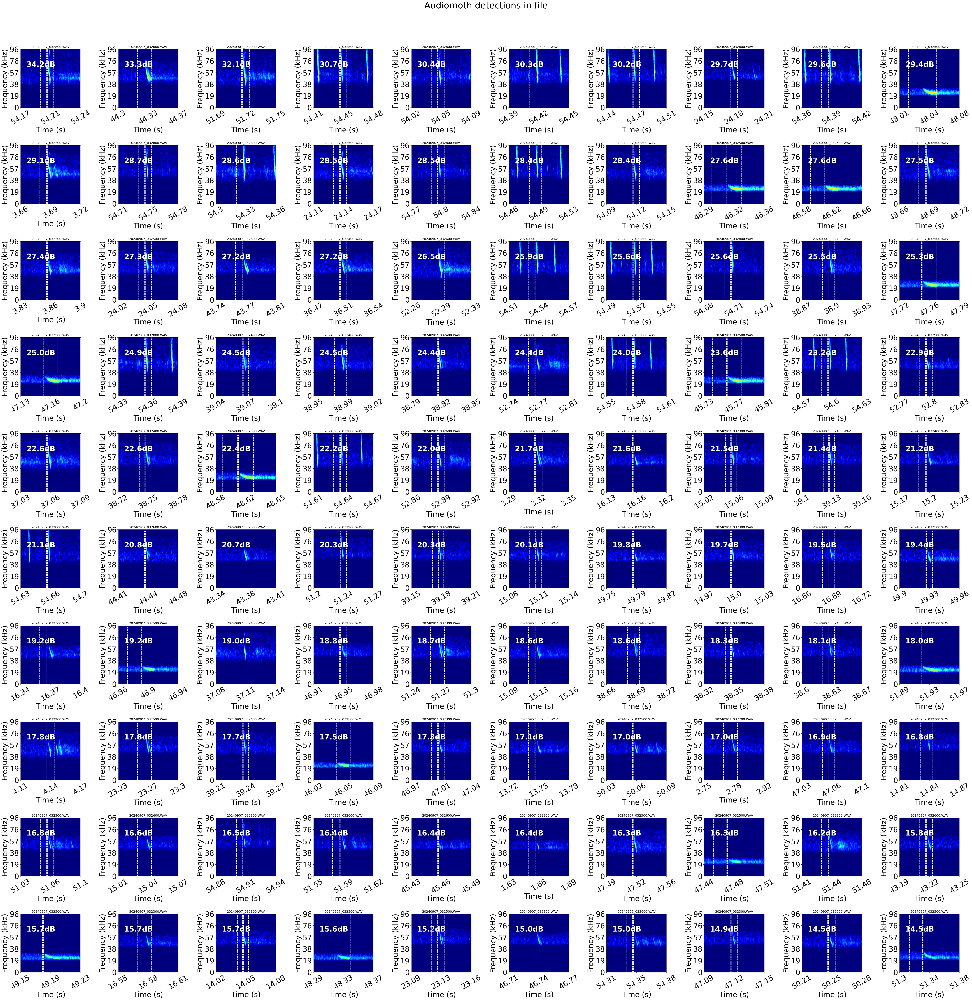

In [65]:
plt.figure(figsize=(6*np.ceil(len(selection_audiomoth)**0.5), 6*np.ceil(len(selection_audiomoth)**0.5)))
plt.rcParams.update({'font.size': 32})
plt.suptitle('Audiomoth detections in file', y=1.02)
for i, row in selection_audiomoth.iterrows():
    filename = Path(row['input_file']).name
    file_path = f'{audiomoth_dir}/{filename}'
    recorded_audio = sf.SoundFile(file_path)
    fs = recorded_audio.samplerate
    win_pad = 0.030
    start = row['start_time'] - win_pad
    call_dur = (row['end_time'] - row['start_time'])
    duration = call_dur + (2*win_pad)

    edge_pad = 0.001
    recorded_audio.seek(int(fs*(row['start_time']-edge_pad)))
    call_sig = recorded_audio.read(int(fs*(call_dur+(2*edge_pad))))
    recorded_audio.seek(int(fs*(row['start_time'] - call_dur - (4*edge_pad))))
    noise_sig = recorded_audio.read(int(fs*(call_dur+(2*edge_pad))))
    snr = get_snr_from_band_limited_signal(call_sig, noise_sig)

    recorded_audio.seek(int(fs*start))
    audio_seg = recorded_audio.read(int(fs*duration))
    nyq = fs // 2
    low_cutoff = (row['low_freq']-2000) / nyq
    high_cutoff =  min(0.99, (row['high_freq']+2000) / nyq)
    b, a = scipy.signal.butter(4, [low_cutoff, high_cutoff], btype='band', analog=False)
    band_limited_audio_seg = scipy.signal.filtfilt(b, a, audio_seg)
    
    lower_dB = -80
    upper_dB = 0
    vmin = lower_dB # hide anything below lower_dB dB
    vmax = upper_dB # hide anything above upper_dB dB
    cmap = 'jet'
    nfft = 132

    plt.subplot(int(np.ceil(len(selection_audiomoth)**0.5)), int(np.ceil(len(selection_audiomoth)**0.5)), i+1)
    plt.title(f"{Path(row['input_file']).name}", fontsize=14)
    plt.specgram(band_limited_audio_seg, NFFT=nfft, cmap=cmap, vmin=vmin, vmax=vmax, mode='magnitude', scale='dB')
    ax = plt.gca()
    plt.text(x=0.1, y=0.7, s=f'{round(row["SNR"],1)}dB', fontweight='bold', color='w', transform=ax.transAxes)
    plt.yticks(ticks=np.linspace(0, 1, 6), labels=np.linspace(0, fs/2000, 6).astype('int'))
    plot_xtype = 'float'
    if (duration > 60):
        plot_xtype = 'int'
    start_time_of_call_sig = (win_pad-edge_pad)
    end_time_of_call_sig = win_pad+(call_dur+edge_pad)
    start_time_of_noise_sig = (win_pad-edge_pad) - (call_dur + (3*edge_pad))
    end_time_of_noise_sig = win_pad-(2*edge_pad)
    plt.axvline(x=start_time_of_call_sig*(fs/2), linestyle='dashed', color='w', linewidth=2)
    plt.axvline(x=end_time_of_call_sig*(fs/2), linestyle='dashed', color='w', linewidth=2)
    plt.axvline(x=start_time_of_noise_sig*(fs/2), linestyle='dashed', color='w', linewidth=2)
    plt.axvline(x=end_time_of_noise_sig*(fs/2), linestyle='dashed', color='w', linewidth=2)
    plt.xticks(ticks=np.linspace(0, duration*(fs/2), 3), 
               labels=np.round(np.linspace(start, start+duration, 3, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Frequency (kHz)")
    plt.xlabel("Time (s)")

plt.tight_layout()
plt.show()

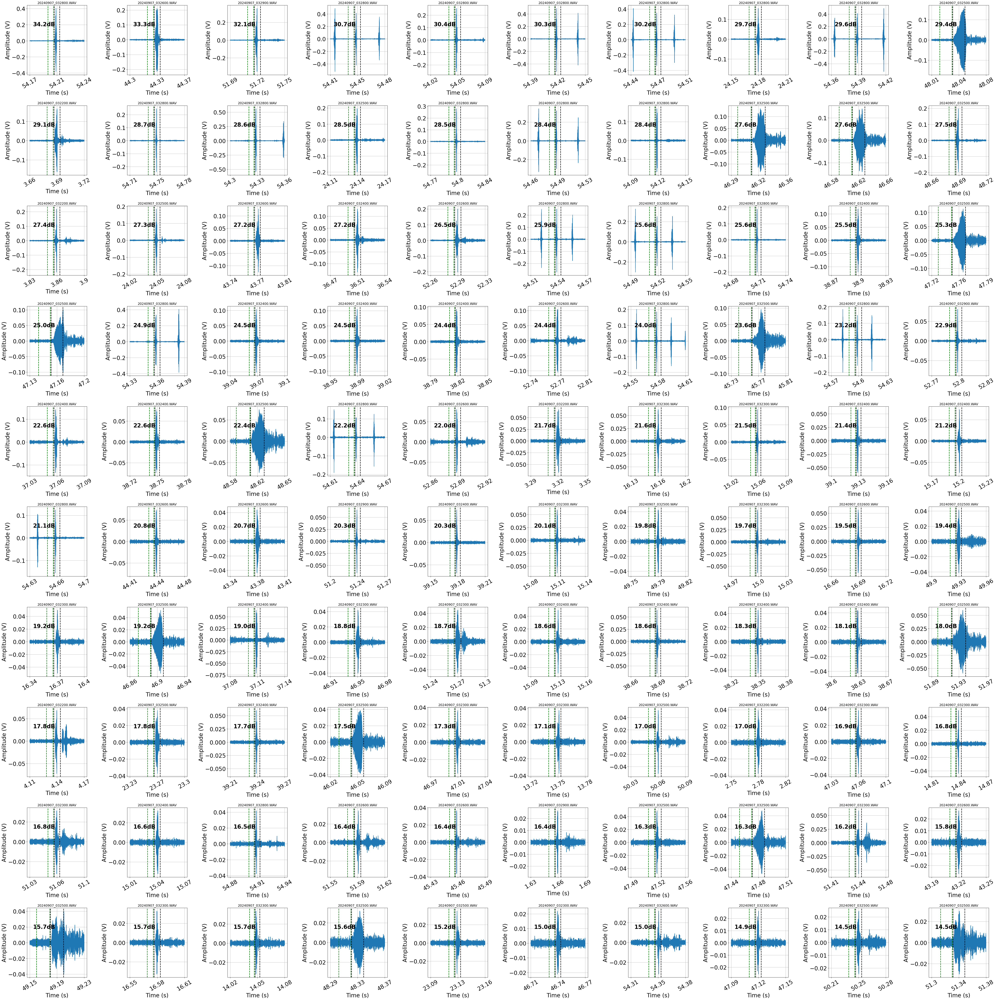

In [52]:
plt.figure(figsize=(6*np.ceil(len(selection_audiomoth)**0.5), 6*np.ceil(len(selection_audiomoth)**0.5)))
plt.rcParams.update({'font.size': 24})
for i, row in selection_audiomoth.iterrows():
    filename = Path(row['input_file']).name
    file_path = f'{audiomoth_dir}/{filename}'
    recorded_audio = sf.SoundFile(file_path)
    fs = recorded_audio.samplerate
    win_pad = 0.030
    start = row['start_time'] - win_pad
    call_dur = (row['end_time'] - row['start_time'])
    duration = call_dur + (2*win_pad)

    edge_pad = 0.001
    recorded_audio.seek(int(fs*(row['start_time']-edge_pad)))
    call_sig = recorded_audio.read(int(fs*(call_dur+(2*edge_pad))))
    recorded_audio.seek(int(fs*(row['start_time']-(call_dur+(4*edge_pad)))))
    noise_sig = recorded_audio.read(int(fs*(call_dur+(2*edge_pad))))
    snr = get_snr_from_band_limited_signal(call_sig, noise_sig)

    recorded_audio.seek(int(fs*start))
    audio_seg = recorded_audio.read(int(fs*duration))
    nyq = fs // 2
    low_cutoff = (row['low_freq']-2000) / nyq
    high_cutoff =  min(0.99, (row['high_freq']+2000) / nyq)
    b, a = scipy.signal.butter(4, [low_cutoff, high_cutoff], btype='band', analog=False)
    band_limited_audio_seg = scipy.signal.filtfilt(b, a, audio_seg)

    lower_dB = -58
    upper_dB = 0
    vmin = lower_dB # hide anything below lower_dB dB
    vmax = upper_dB # hide anything above upper_dB dB
    cmap = 'jet'
    nfft = 132

    plt.subplot(int(np.ceil(len(selection_audiomoth)**0.5)), int(np.ceil(len(selection_audiomoth)**0.5)), i+1)
    plt.title(f"{Path(row['input_file']).name}", fontsize=14)
    plt.plot(band_limited_audio_seg)
    ax = plt.gca()
    plt.text(x=0.1, y=0.7, s=f'{round(row["SNR"],1)}dB', fontweight='bold', color='k', transform=ax.transAxes)
    plot_xtype = 'float'
    if (duration > 60):
        plot_xtype = 'int'
    plt.grid(which='both')
    start_time_of_call_sig = (win_pad-edge_pad)
    end_time_of_call_sig = win_pad+(call_dur+edge_pad)
    start_time_of_noise_sig = (win_pad-edge_pad) - (call_dur + (3*edge_pad))
    end_time_of_noise_sig = win_pad-(2*edge_pad)
    plt.axvline(x=start_time_of_call_sig*fs, linestyle='dashed', color='k', linewidth=2)
    plt.axvline(x=end_time_of_call_sig*fs, linestyle='dashed', color='k', linewidth=2)
    plt.axvline(x=start_time_of_noise_sig*fs, linestyle='dashed', color='g', linewidth=2)
    plt.axvline(x=end_time_of_noise_sig*fs, linestyle='dashed', color='g', linewidth=2)
    plt.xticks(ticks=np.linspace(0, duration*(fs), 3), 
               labels=np.round(np.linspace(start, start+duration, 3, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Amplitude (V)")
    plt.xlabel("Time (s)")

plt.tight_layout()
plt.show()

In [72]:
import dask.dataframe as dd

all_arraymic_files = dd.read_csv('../output_dir/mic_array_test_20240906/batdetect2_pipeline_recording_test_*.csv').compute()
all_arraymic_files

,KMEANS_CLASSES,peak_frequency,SNR,start_time,end_time,low_freq,high_freq,event,class,class_prob,det_prob,individual,sampling_rate,input_file
0,HF,95040.0,3.394651,192.7975,192.8296,93359.0,111478.0,Echolocation,Rhinolophus hipposideros,0.508,0.508,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
1,HF,95040.0,8.202867,291.2685,291.3091,93359.0,111106.0,Echolocation,Rhinolophus hipposideros,0.524,0.524,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
2,HF,95040.0,5.214724,220.0885,220.1234,93359.0,111774.0,Echolocation,Rhinolophus hipposideros,0.52,0.52,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
3,HF,95040.0,4.405836,194.7005,194.7333,93359.0,111762.0,Echolocation,Rhinolophus hipposideros,0.51,0.51,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
4,HF,95040.0,8.98912,220.5725,220.6123,93359.0,111273.0,Echolocation,Rhinolophus hipposideros,0.558,0.558,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
524,HF,48960.0,2.335525,26.3135,26.3178,42656.0,62558.0,Echolocation,Myotis mystacinus,0.183,0.56,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
525,HF,48960.0,1.824754,26.4865,26.4906,41796.0,61296.0,Echolocation,Myotis alcathoe,0.19,0.595,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
526,HF,48960.0,6.098749,26.6215,26.626,40078.0,70908.0,Echolocation,Myotis alcathoe,0.341,0.521,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
527,HF,53760.0,5.597052,28.4715,28.4749,40937.0,60397.0,Echolocation,Myotis brandtii,0.196,0.512,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...


In [25]:
mic_array_dir = '/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/mic_array'
files_from_loc = sorted(list(Path(mic_array_dir).glob(pattern='recording*.tdms')))
files_from_loc

[PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/mic_array/recording_test_1.tdms'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/mic_array/recording_test_2.tdms'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/mic_array/recording_test_3_in_balcony_start_073300.tdms'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/mic_array/recording_test_4_in_balcony_start_073500.tdms'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/mic_array/recording_test_5_in_balcony_start_074500.tdms'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/mic_array/recording_test_6_in_balcony_start_080000.tdms'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/adityas-home/mic-array-test-20240906/mic_array/recording_test_7_in_balcony_start_081300.tdms'),
 PosixPath('/Volumes/Elements/UBNA_array_tests/

Generating detections for recording_test_8_in_balcony_start_082000.WAV
Median LF frequency in File: 24960.0
Median HF frequency in File: 52800.0


100%|██████████| 20/20 [02:58<00:00,  8.94s/it]


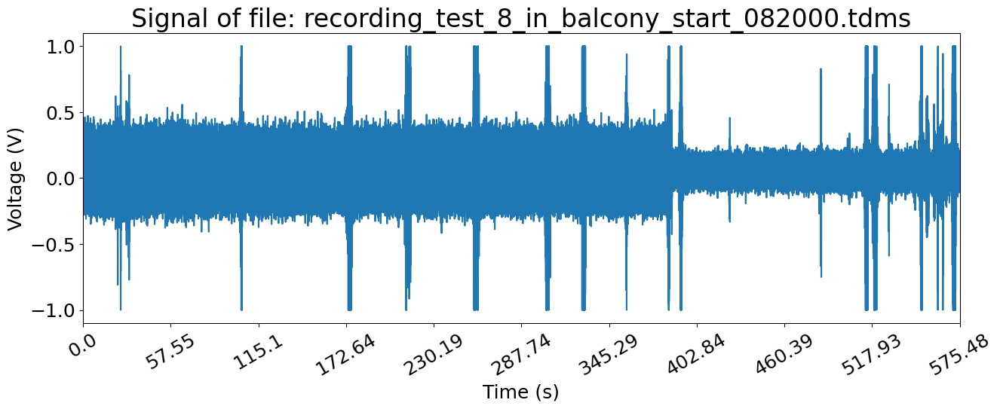

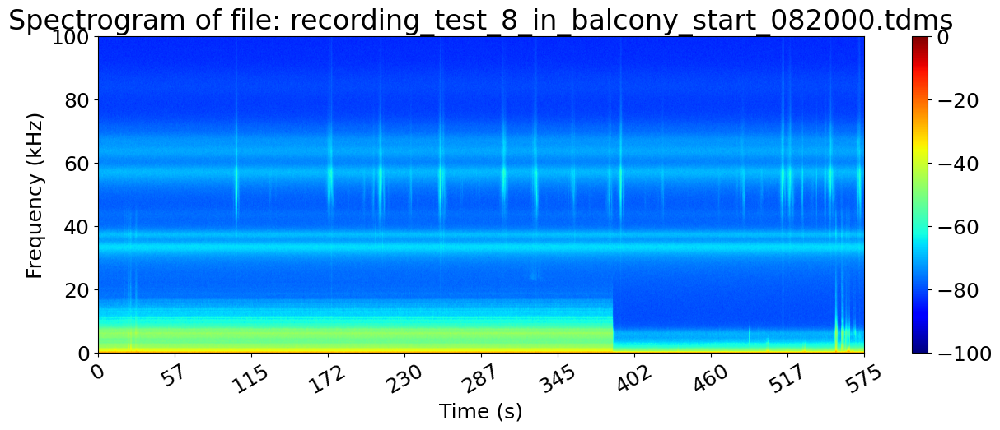

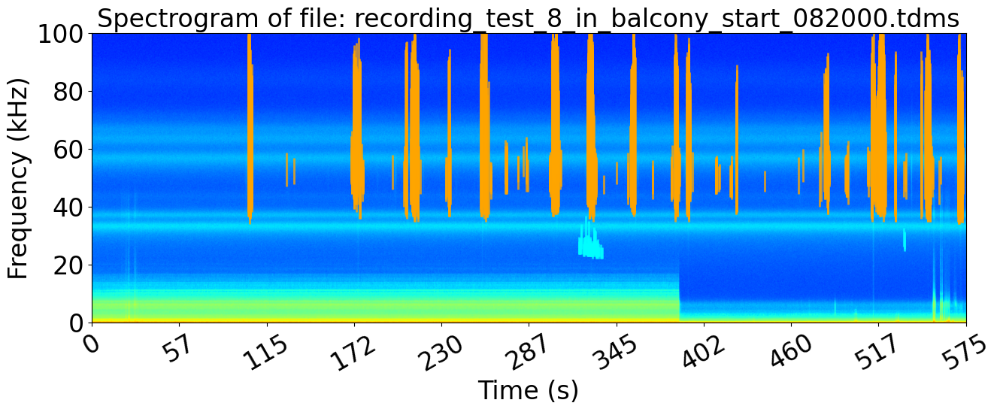

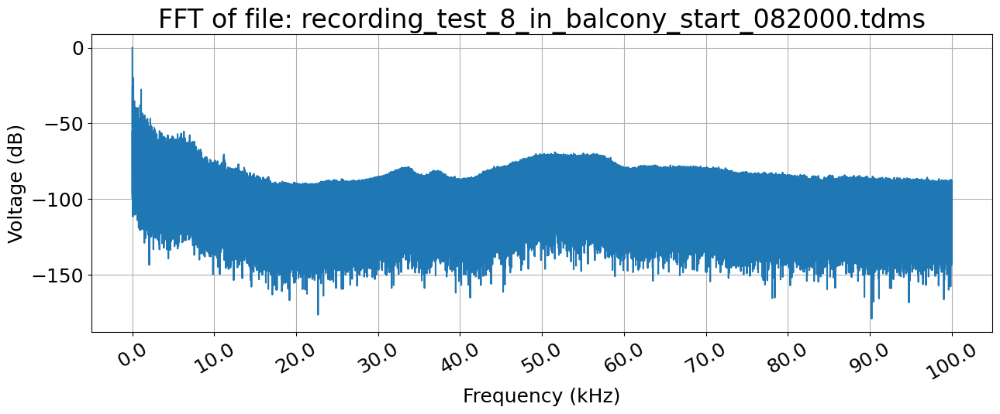

In [26]:
for file in files_from_loc[7:8]:
    # tdms_file = TdmsFile.read(file)
    # group_name = tdms_file.groups()[0].name
    # group = tdms_file[group_name]
    # channel_name = group.channels()[0].name
    # channel = group[channel_name]
    fs = 200000

    write_file = Path(f'{mic_array_dir}/{file.name.split(".")[0]}.WAV')
    # sf.write(write_file, channel[:], int(fs))
    cfg['input_audio'] = Path(write_file)
    dets = run_pipeline_on_file(write_file, cfg)
    recorded_audio = sf.SoundFile(write_file)

    max_dur = 600
    start = 0
    # for start in np.arange(0, (recorded_audio.frames/fs)-1, max_dur):
    recorded_audio.seek(int(fs*start))
    duration = min(max_dur, (recorded_audio.frames - recorded_audio.tell()) / fs)
    audio_seg = recorded_audio.read(int(fs*duration))
    vmax = 0
    vmin = -100

    audio_features = dict()
    audio_features['file_path'] = Path(file)
    audio_features['audio_seg'] = audio_seg
    audio_features['sample_rate'] = fs
    audio_features['start'] = start
    audio_features['duration'] = duration

    spec_features = dict()
    spec_features['NFFT'] = 1024 # When segments are short, NFFT should also be small to best see calls (must always be > 128)
    spec_features['cmap'] = 'jet' # This colormap shows best contrast between noise and signals
    spec_features['vmin'] = vmin
    spec_features['vmax'] = vmax

    audio_features['plot_title'] = f"file: {audio_features['file_path'].name}"
    plot_audio_seg_signal(audio_features)
    plot_audio_seg_spec(audio_features, spec_features)
    plot_dets = dets.loc[(dets['start_time']>=start)&(dets['end_time']<=(start+duration))]
    plot_dets = plot_dets.sort_values(by='start_time')
    plot_dets.reset_index(drop=True, inplace=True)
    plot_colored_dets_over_audio(audio_features, spec_features, plot_dets)
    plot_audio_seg_fft(audio_features)

In [55]:
lf_dets = dets[dets['KMEANS_CLASSES']=='LF']
hf_dets = dets[dets['KMEANS_CLASSES']=='HF']

In [43]:
selection_array_mic = dets.sort_values(by='SNR', ascending=False)[:100].reset_index(drop=True).copy()
selection_array_mic

,KMEANS_CLASSES,peak_frequency,SNR,start_time,end_time,low_freq,high_freq,event,class,class_prob,det_prob,individual,sampling_rate,input_file
0,HF,57600.0,40.260397,175.6895,175.6949,40937.0,98606.0,Echolocation,Myotis alcathoe,0.495,0.514,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
1,HF,49920.0,36.363537,384.3485,384.3543,35781.0,102909.0,Echolocation,Myotis alcathoe,0.481,0.504,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
2,HF,49920.0,36.159478,104.2675,104.2738,36640.0,94226.0,Echolocation,Myotis alcathoe,0.586,0.618,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
3,HF,52800.0,36.034065,212.2565,212.2622,37500.0,109186.0,Echolocation,Myotis alcathoe,0.464,0.520,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
4,HF,53760.0,35.852464,328.5345,328.5398,41796.0,100020.0,Echolocation,Myotis alcathoe,0.460,0.504,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,HF,55680.0,29.444860,258.8945,258.9002,38359.0,106734.0,Echolocation,Myotis alcathoe,0.468,0.520,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
96,HF,56640.0,29.443146,392.3145,392.3198,36640.0,87288.0,Echolocation,Myotis alcathoe,0.430,0.550,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
97,HF,50880.0,29.399854,357.1045,357.1104,36640.0,96881.0,Echolocation,Myotis alcathoe,0.667,0.677,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...
98,HF,52800.0,29.370614,174.9445,174.9497,44375.0,87938.0,Echolocation,Myotis alcathoe,0.401,0.544,-1,200000.0,/Volumes/Elements/UBNA_array_tests/adityas-hom...


Text(0.5, 0, 'SNR')

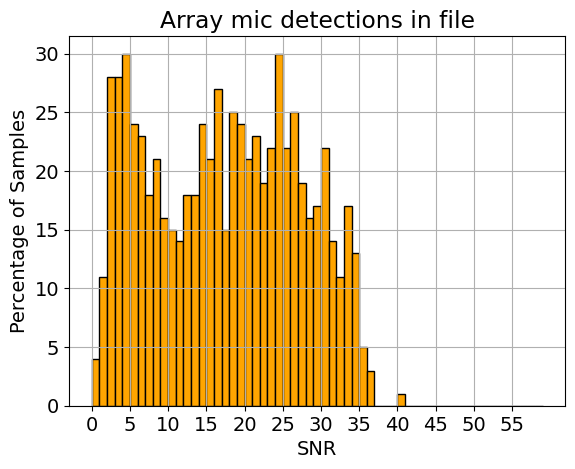

In [54]:
plt.rcParams.update({'font.size':14})
(dets['SNR'].sort_values()).hist(bins=np.arange(0, 60, 1), facecolor='orange', edgecolor='k', density=False)
# plt.yscale('log')
plt.title('Array mic detections in file')
plt.xticks(np.arange(0, 60, 5))
plt.ylabel('Percentage of Samples')
plt.xlabel('SNR')

Text(0.5, 0, 'SNR')

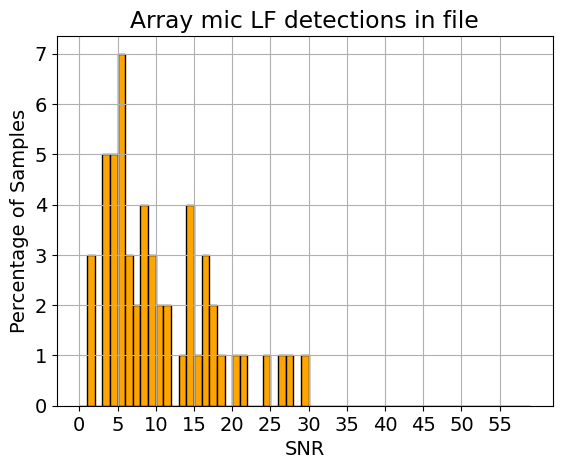

In [73]:
plt.rcParams.update({'font.size':14})
(lf_dets['SNR'].sort_values()).hist(bins=np.arange(0, 60, 1), facecolor='orange', edgecolor='k', density=False)
# plt.yscale('log')
plt.title('Array mic LF detections in file')
plt.xticks(np.arange(0, 60, 5))
plt.ylabel('Percentage of Samples')
plt.xlabel('SNR')

Text(0.5, 0, 'SNR')

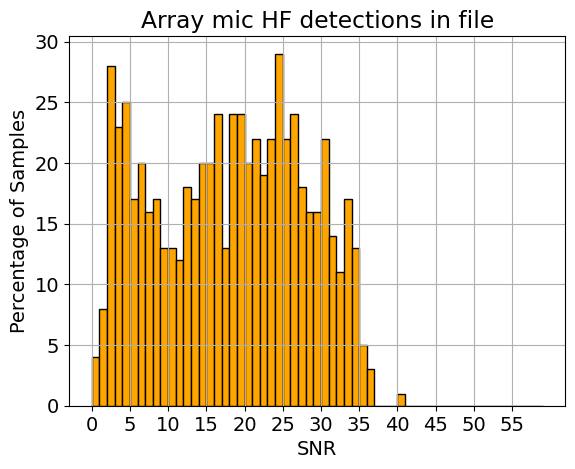

In [72]:
plt.rcParams.update({'font.size':14})
(hf_dets['SNR'].sort_values()).hist(bins=np.arange(0, 60, 1), facecolor='orange', edgecolor='k', density=False)
# plt.yscale('log')
plt.title('Array mic HF detections in file')
plt.xticks(np.arange(0, 60, 5))
plt.ylabel('Percentage of Samples')
plt.xlabel('SNR')

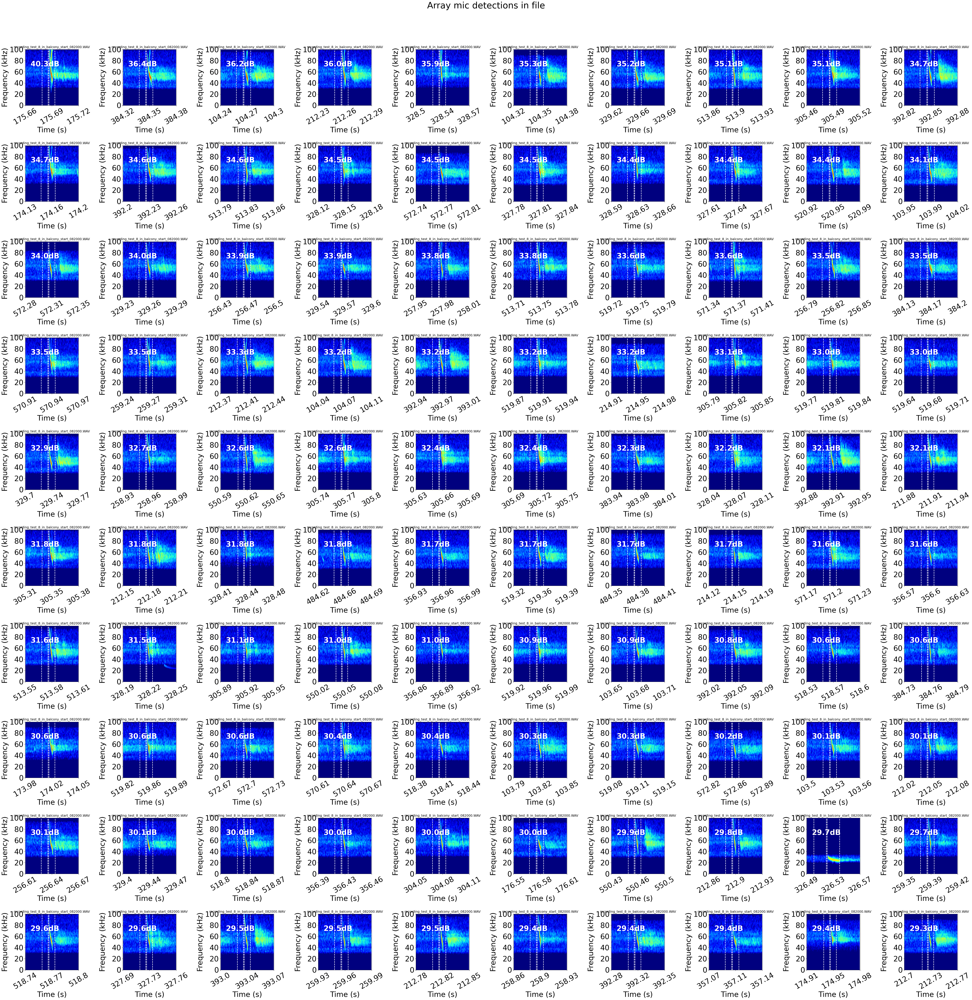

In [64]:
plt.figure(figsize=(6*np.ceil(len(selection_array_mic)**0.5), 6*np.ceil(len(selection_array_mic)**0.5)))
plt.rcParams.update({'font.size': 32})
plt.suptitle('Array mic detections in file', y=1.02)
for i, row in selection_array_mic.iterrows():
    # filename = Path(row['input_file']).name
    # file_path = f"{mic_array_dir}/{filename}"
    recorded_audio = sf.SoundFile(row['input_file'])
    fs = recorded_audio.samplerate
    win_pad = 0.030
    start = row['start_time'] - win_pad
    call_dur = (row['end_time'] - row['start_time'])
    duration = call_dur + (2*win_pad)

    edge_pad = 0.001
    recorded_audio.seek(int(fs*(row['start_time']-edge_pad)))
    call_sig = recorded_audio.read(int(fs*(call_dur+(2*edge_pad))))
    recorded_audio.seek(int(fs*(row['start_time'] - call_dur - (4*edge_pad))))
    noise_sig = recorded_audio.read(int(fs*(call_dur+(2*edge_pad))))
    snr = get_snr_from_band_limited_signal(call_sig, noise_sig)

    recorded_audio.seek(int(fs*start))
    audio_seg = recorded_audio.read(int(fs*duration))
    nyq = fs // 2
    low_cutoff = (row['low_freq']-2000) / nyq
    high_cutoff =  min(0.99, (row['high_freq']+2000) / nyq)
    b, a = scipy.signal.butter(4, [low_cutoff, high_cutoff], btype='band', analog=False)
    band_limited_audio_seg = scipy.signal.filtfilt(b, a, audio_seg)
    
    lower_dB = -80
    upper_dB = 0
    vmin = lower_dB # hide anything below lower_dB dB
    vmax = upper_dB # hide anything above upper_dB dB
    cmap = 'jet'
    nfft = 132

    plt.subplot(int(np.ceil(len(selection_array_mic)**0.5)), int(np.ceil(len(selection_array_mic)**0.5)), i+1)
    plt.title(f"{Path(row['input_file']).name.split('_sample')[0]}", fontsize=14)
    plt.specgram(band_limited_audio_seg, NFFT=nfft, cmap=cmap, vmin=vmin, vmax=vmax, mode='magnitude', scale='dB')
    ax = plt.gca()
    plt.text(x=0.1, y=0.7, s=f'{round(row["SNR"],1)}dB', fontweight='bold', color='w', transform=ax.transAxes)
    plt.yticks(ticks=np.linspace(0, 1, 6), labels=np.linspace(0, fs/2000, 6).astype('int'))
    plot_xtype = 'float'
    if (duration > 60):
        plot_xtype = 'int'
    start_time_of_call_sig = (win_pad-edge_pad)
    end_time_of_call_sig = win_pad+(call_dur+edge_pad)
    start_time_of_noise_sig = (win_pad-edge_pad) - (call_dur + (3*edge_pad))
    end_time_of_noise_sig = win_pad-(2*edge_pad)
    plt.axvline(x=start_time_of_call_sig*(fs/2), linestyle='dashed', color='w', linewidth=2)
    plt.axvline(x=end_time_of_call_sig*(fs/2), linestyle='dashed', color='w', linewidth=2)
    plt.axvline(x=start_time_of_noise_sig*(fs/2), linestyle='dashed', color='w', linewidth=2)
    plt.axvline(x=end_time_of_noise_sig*(fs/2), linestyle='dashed', color='w', linewidth=2)
    plt.xticks(ticks=np.linspace(0, duration*(fs/2), 3), 
               labels=np.round(np.linspace(start, start+duration, 3, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Frequency (kHz)")
    plt.xlabel("Time (s)")

plt.tight_layout()
plt.show()

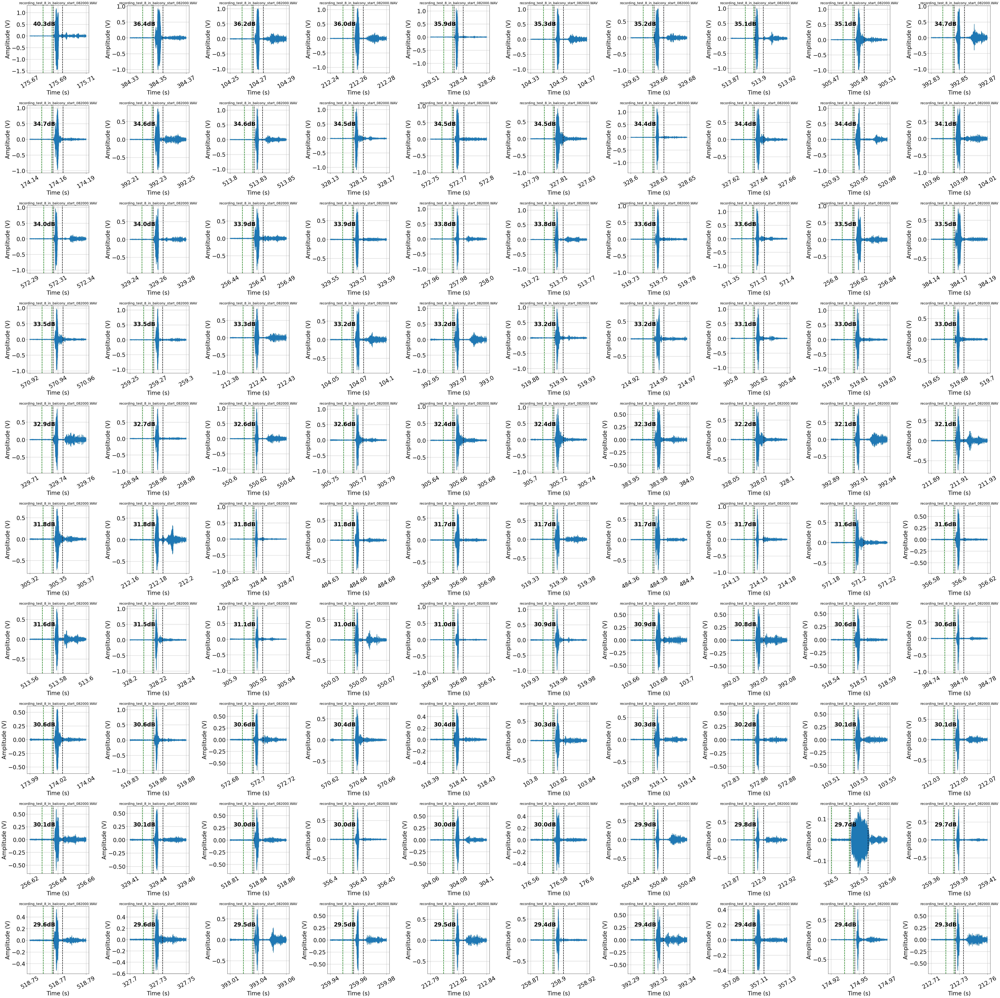

In [48]:
plt.figure(figsize=(6*np.ceil(len(selection_array_mic)**0.5), 6*np.ceil(len(selection_array_mic)**0.5)))
plt.rcParams.update({'font.size': 24})
for i, row in selection_array_mic.iterrows():
    # filename = Path(row['input_file']).name
    # file_path = f"{mic_array_dir}/{filename}"
    recorded_audio = sf.SoundFile(row['input_file'])
    fs = recorded_audio.samplerate
    win_pad = 0.02
    start = row['start_time'] - win_pad
    call_dur = (row['end_time'] - row['start_time'])
    duration = call_dur + (2*win_pad)

    edge_pad = 0.001
    recorded_audio.seek(int(fs*(row['start_time']-edge_pad)))
    call_sig = recorded_audio.read(int(fs*(call_dur+(2*edge_pad))))
    # band_limited_call_sig = bandpass_audio_signal(call_sig, fs, row['low_freq']-2000, row['high_freq']+2000)
    recorded_audio.seek(int(fs*(row['start_time']-(call_dur+(4*edge_pad)))))
    noise_sig = recorded_audio.read(int(fs*(call_dur+(2*edge_pad))))
    # band_limited_noise_sig = bandpass_audio_signal(noise_sig, fs, row['low_freq']-2000, row['high_freq']+2000)
    snr = get_snr_from_band_limited_signal(call_sig, noise_sig)

    recorded_audio.seek(int(fs*start))
    audio_seg = recorded_audio.read(int(fs*duration))
    nyq = fs // 2
    low_cutoff = (row['low_freq']-2000) / nyq
    high_cutoff =  min(0.99, (row['high_freq']+2000) / nyq)
    b, a = scipy.signal.butter(4, [low_cutoff, high_cutoff], btype='band', analog=False)
    band_limited_audio_seg = scipy.signal.filtfilt(b, a, audio_seg)
    
    lower_dB = -80
    upper_dB = 0
    vmin = lower_dB # hide anything below lower_dB dB
    vmax = upper_dB # hide anything above upper_dB dB
    cmap = 'jet'
    nfft = 132

    plt.subplot(int(np.ceil(len(selection_array_mic)**0.5)), int(np.ceil(len(selection_array_mic)**0.5)), i+1)
    plt.title(f"{Path(row['input_file']).name}", fontsize=14)
    plt.plot(band_limited_audio_seg)
    ax = plt.gca()
    plt.text(x=0.1, y=0.7, s=f'{round(row["SNR"],1)}dB', fontweight='bold', color='k', transform=ax.transAxes)
    plot_xtype = 'float'
    if (duration > 60):
        plot_xtype = 'int'
    plt.grid(which='both')
    start_time_of_call_sig = (win_pad-edge_pad)
    end_time_of_call_sig = win_pad+(call_dur+edge_pad)
    start_time_of_noise_sig = (win_pad-edge_pad) - (call_dur + (3*edge_pad))
    end_time_of_noise_sig = win_pad-(2*edge_pad)
    plt.axvline(x=start_time_of_call_sig*fs, linestyle='dashed', color='k', linewidth=2)
    plt.axvline(x=end_time_of_call_sig*fs, linestyle='dashed', color='k', linewidth=2)
    plt.axvline(x=start_time_of_noise_sig*fs, linestyle='dashed', color='g', linewidth=2)
    plt.axvline(x=end_time_of_noise_sig*fs, linestyle='dashed', color='g', linewidth=2)
    plt.xticks(ticks=np.linspace(0, duration*(fs), 3), 
               labels=np.round(np.linspace(start, start+duration, 3, dtype=plot_xtype), 2), rotation=30)
    plt.ylabel("Amplitude (V)")
    plt.xlabel("Time (s)")

plt.tight_layout()
plt.show()